Load Packages

In [1]:
# Import libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
import glob
import re
import os

In [2]:
plt.rcParams['font.family'] = 'Times New Roman'

## Baselines

Load dataframes of 48 THINGS embeddings

In [5]:
baseline_seed1_48_things_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results')

# Find all training run files from the single epoch perturbation sweep
baseline_seed1_48_things_files = sorted([f for f in baseline_seed1_48_things_dir.glob('things_48_embeddings*') if f.is_file()])

print(f"Found {len(baseline_seed1_48_things_files)} epochs:")
for run_dir in baseline_seed1_48_things_files:
    print(f"  - {run_dir.name}")

Found 98 epochs:
  - things_48_embeddings_epoch1.csv
  - things_48_embeddings_epoch10.csv
  - things_48_embeddings_epoch11.csv
  - things_48_embeddings_epoch12.csv
  - things_48_embeddings_epoch13.csv
  - things_48_embeddings_epoch14.csv
  - things_48_embeddings_epoch15.csv
  - things_48_embeddings_epoch16.csv
  - things_48_embeddings_epoch17.csv
  - things_48_embeddings_epoch18.csv
  - things_48_embeddings_epoch19.csv
  - things_48_embeddings_epoch2.csv
  - things_48_embeddings_epoch20.csv
  - things_48_embeddings_epoch21.csv
  - things_48_embeddings_epoch22.csv
  - things_48_embeddings_epoch23.csv
  - things_48_embeddings_epoch24.csv
  - things_48_embeddings_epoch25.csv
  - things_48_embeddings_epoch26.csv
  - things_48_embeddings_epoch27.csv
  - things_48_embeddings_epoch28.csv
  - things_48_embeddings_epoch29.csv
  - things_48_embeddings_epoch3.csv
  - things_48_embeddings_epoch30.csv
  - things_48_embeddings_epoch31.csv
  - things_48_embeddings_epoch32.csv
  - things_48_embeddings

In [19]:
baseline_seed1_48_things_paths = [baseline_seed1_48_things_dir / f.name for f in baseline_seed1_48_things_files]

baseline_seed1_48_things_dict = {}

# loop through the files and read in the embeddings
for path in baseline_seed1_48_things_paths:
    epoch = path.name.split('_')[3].split('.')[0]
    embeddings = pd.read_csv(path)
    baseline_seed1_48_things_dict[epoch] = embeddings

print(baseline_seed1_48_things_dict.keys())

# turn the dict into a dataframe and add the epoch as a column
baseline_seed1_48_things_df = pd.concat(
    [df.assign(epoch=epoch) for epoch, df in baseline_seed1_48_things_dict.items()],
    ignore_index=True
)

print(baseline_seed1_48_things_df.tail())


dict_keys(['epoch1', 'epoch10', 'epoch11', 'epoch12', 'epoch13', 'epoch14', 'epoch15', 'epoch16', 'epoch17', 'epoch18', 'epoch19', 'epoch2', 'epoch20', 'epoch21', 'epoch22', 'epoch23', 'epoch24', 'epoch25', 'epoch26', 'epoch27', 'epoch28', 'epoch29', 'epoch3', 'epoch30', 'epoch31', 'epoch32', 'epoch33', 'epoch34', 'epoch35', 'epoch36', 'epoch37', 'epoch38', 'epoch39', 'epoch4', 'epoch40', 'epoch41', 'epoch42', 'epoch43', 'epoch44', 'epoch45', 'epoch46', 'epoch47', 'epoch48', 'epoch49', 'epoch5', 'epoch50', 'epoch51', 'epoch52', 'epoch53', 'epoch54', 'epoch55', 'epoch56', 'epoch57', 'epoch58', 'epoch59', 'epoch6', 'epoch60', 'epoch61', 'epoch62', 'epoch63', 'epoch64', 'epoch65', 'epoch66', 'epoch67', 'epoch68', 'epoch69', 'epoch7', 'epoch70', 'epoch71', 'epoch72', 'epoch73', 'epoch74', 'epoch75', 'epoch76', 'epoch77', 'epoch78', 'epoch79', 'epoch8', 'epoch80', 'epoch81', 'epoch82', 'epoch83', 'epoch84', 'epoch85', 'epoch86', 'epoch87', 'epoch88', 'epoch89', 'epoch9', 'epoch90', 'epoch91

In [63]:
baseline_seed2_48_things_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed2/inference_results/things_48_inference_results')

# Find all training run files from the single epoch perturbation sweep
baseline_seed2_48_things_files = sorted([f for f in baseline_seed2_48_things_dir.glob('things_48_embeddings*') if f.is_file()])

print(f"Found {len(baseline_seed2_48_things_files)} training runs:")
for run_dir in baseline_seed2_48_things_files:
    print(f"  - {run_dir.name}")

baseline_seed2_48_things_paths = [baseline_seed2_48_things_dir / f.name for f in baseline_seed2_48_things_files]

baseline_seed2_48_things_dict = {}

# loop through the files and read in the embeddings
for path in baseline_seed2_48_things_paths:
    epoch = path.name.split('_')[3].split('.')[0]
    embeddings = pd.read_csv(path)
    baseline_seed2_48_things_dict[epoch] = embeddings

print(baseline_seed2_48_things_dict.keys())

# turn the dict into a dataframe and add the epoch as a column
baseline_seed2_48_things_df = pd.concat(
    [df.assign(epoch=epoch) for epoch, df in baseline_seed2_48_things_dict.items()],
    ignore_index=True
)

print(baseline_seed2_48_things_df.tail())

Found 92 training runs:
  - things_48_embeddings_epoch1.csv
  - things_48_embeddings_epoch10.csv
  - things_48_embeddings_epoch11.csv
  - things_48_embeddings_epoch12.csv
  - things_48_embeddings_epoch13.csv
  - things_48_embeddings_epoch14.csv
  - things_48_embeddings_epoch15.csv
  - things_48_embeddings_epoch16.csv
  - things_48_embeddings_epoch17.csv
  - things_48_embeddings_epoch18.csv
  - things_48_embeddings_epoch19.csv
  - things_48_embeddings_epoch2.csv
  - things_48_embeddings_epoch20.csv
  - things_48_embeddings_epoch21.csv
  - things_48_embeddings_epoch22.csv
  - things_48_embeddings_epoch23.csv
  - things_48_embeddings_epoch24.csv
  - things_48_embeddings_epoch25.csv
  - things_48_embeddings_epoch26.csv
  - things_48_embeddings_epoch27.csv
  - things_48_embeddings_epoch28.csv
  - things_48_embeddings_epoch29.csv
  - things_48_embeddings_epoch3.csv
  - things_48_embeddings_epoch30.csv
  - things_48_embeddings_epoch31.csv
  - things_48_embeddings_epoch32.csv
  - things_48_emb

In [ ]:





baseline_seed3_48_things_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed3/inference_results/things_48_inference_results')

# Find all training run files from the single epoch perturbation sweep
baseline_seed3_48_things_files = sorted([f for f in baseline_seed3_48_things_dir.glob('things_48_embeddings*') if f.is_file()])

print(f"Found {len(baseline_seed3_48_things_files)} training runs:")
for run_dir in baseline_seed3_48_things_files:
    print(f"  - {run_dir.name}")

baseline_seed3_48_things_paths = [baseline_seed3_48_things_dir / f.name for f in baseline_seed3_48_things_files]

baseline_seed3_48_things_dict = {}

# loop through the files and read in the embeddings
for path in baseline_seed3_48_things_paths:
    epoch = path.name.split('_')[3].split('.')[0]
    embeddings = pd.read_csv(path)
    baseline_seed3_48_things_dict[epoch] = embeddings

print(baseline_seed3_48_things_dict.keys())

# turn the dict into a dataframe and add the epoch as a column
baseline_seed3_48_things_df = pd.concat(
    [df.assign(epoch=epoch) for epoch, df in baseline_seed3_48_things_dict.items()],
    ignore_index=True
)

print(baseline_seed3_48_things_df.tail())

Found 103 training runs:
  - things_48_embeddings_epoch1.csv
  - things_48_embeddings_epoch10.csv
  - things_48_embeddings_epoch100.csv
  - things_48_embeddings_epoch101.csv
  - things_48_embeddings_epoch102.csv
  - things_48_embeddings_epoch103.csv
  - things_48_embeddings_epoch11.csv
  - things_48_embeddings_epoch12.csv
  - things_48_embeddings_epoch13.csv
  - things_48_embeddings_epoch14.csv
  - things_48_embeddings_epoch15.csv
  - things_48_embeddings_epoch16.csv
  - things_48_embeddings_epoch17.csv
  - things_48_embeddings_epoch18.csv
  - things_48_embeddings_epoch19.csv
  - things_48_embeddings_epoch2.csv
  - things_48_embeddings_epoch20.csv
  - things_48_embeddings_epoch21.csv
  - things_48_embeddings_epoch22.csv
  - things_48_embeddings_epoch23.csv
  - things_48_embeddings_epoch24.csv
  - things_48_embeddings_epoch25.csv
  - things_48_embeddings_epoch26.csv
  - things_48_embeddings_epoch27.csv
  - things_48_embeddings_epoch28.csv
  - things_48_embeddings_epoch29.csv
  - things_

Look at which dimensions change the most between the first and last epochs.

In [30]:
# select all the rows in the baseline_seed1_48_things_df where epoch is 'epoch1'
baseline_seed1_48_things_df_epoch1 = baseline_seed1_48_things_df[baseline_seed1_48_things_df['epoch'] == 'epoch1']

print(baseline_seed1_48_things_df_epoch1)

# select all the rows in the baseline_seed1_48_things_df where epoch is 'epoch98'
baseline_seed1_48_things_df_epoch98 = baseline_seed1_48_things_df[baseline_seed1_48_things_df['epoch'] == 'epoch98']

print(baseline_seed1_48_things_df_epoch98)


                     image          0          1          2          3  \
0            pizza_01b.jpg   6.943114  15.599767  11.636721   6.773570   
1           beaver_01b.jpg   7.223513   8.017966  11.591485   6.929740   
2        macadamia_01b.jpg  10.292803  13.199526  11.482669  11.987718   
3        tarantula_01b.jpg   7.184866   8.734017  14.029031  12.680639   
4          clothes_01b.jpg  12.073318   8.573022  10.531206  15.179026   
5          doormat_01b.jpg  10.962253   8.618795  11.226881  12.751110   
6           hammer_01b.jpg  13.734033   8.450418  10.958121  10.690629   
7        mistletoe_01b.jpg   9.526073   9.547226   8.164411  10.387193   
8        washcloth_01b.jpg   8.625125   9.130649   6.863123  12.877670   
9            drain_01b.jpg  13.833113   8.087058  11.464775  11.580210   
10         furnace_01b.jpg  12.609008   6.566987   7.330486   9.957274   
11             tea_01b.jpg   8.824909  10.941963   8.976460  11.269738   
12         chariot_01b.jpg  11.887678 

In [65]:
# Get epoch1 and epoch98 dataframes, sorted by image to ensure alignment
epoch1_df = baseline_seed1_48_things_df_epoch1.sort_values('image').reset_index(drop=True)
epoch98_df = baseline_seed1_48_things_df_epoch98.sort_values('image').reset_index(drop=True)

# Get all columns except 'image' and 'epoch' (these should be the embedding columns)
embedding_columns = [col for col in epoch1_df.columns if col not in ['image', 'epoch']]

# Ensure we have exactly 66 embedding columns (0-65)
assert len(embedding_columns) == 66, f"Expected 66 embedding columns, found {len(embedding_columns)}"

# Calculate the difference: epoch98 - epoch1, then take absolute value
embedding_diff = epoch98_df[embedding_columns].values - epoch1_df[embedding_columns].values
embedding_diff = np.abs(embedding_diff)

# Create the result dataframe with 'image' column and 66 embedding difference columns
baseline_seed1_embedding_diff = pd.DataFrame(
    embedding_diff,
    columns=embedding_columns
)
baseline_seed1_embedding_diff.insert(0, 'image', epoch1_df['image'].values)

print(baseline_seed1_embedding_diff.head())
print(f"\nShape: {baseline_seed1_embedding_diff.shape}")
print(f"Columns: {list(baseline_seed1_embedding_diff.columns[:5])} ... {list(baseline_seed1_embedding_diff.columns[-5:])}")

                image          0         1          2          3          4  \
0         bag_01b.jpg  15.356791  1.994052   9.358155  40.145767   6.199380   
1      beaver_01b.jpg  10.015087  3.905767  71.464405   5.318587   3.434072   
2       bench_01b.jpg   1.196383  7.003617  12.599129   8.257889  25.305190   
3   bookshelf_01b.jpg  25.740681  6.051970  12.816352   1.431751   5.939503   
4  bowler_hat_01b.jpg   5.900137  3.104994   7.550862  21.474451   2.939374   

           5          6          7          8  ...         56        57  \
0   4.367984   0.556513  14.342276   4.188085  ...   9.315251  8.924660   
1   9.867010  11.985317   6.327597   0.488195  ...   6.311448  6.171639   
2   9.083924   9.071960   5.703764   9.096578  ...  11.731359  9.468324   
3  27.978644  10.442079   7.088656  13.267788  ...   8.023770  9.419237   
4  11.139139   3.511586   1.636440  17.209309  ...   8.173025  7.936967   

          58         59        60         61         62        63         

In [66]:
# Calculate the mean of each numeric column (0-65) across all images
# Get all columns except 'image'
numeric_columns = [col for col in baseline_seed1_embedding_diff.columns if col != 'image']
embedding_mean_diff = baseline_seed1_embedding_diff[numeric_columns].mean()

print("Mean absolute embedding differences per dimension:")
print(embedding_mean_diff)
print(f"\nShape: {embedding_mean_diff.shape}")
print(f"Total mean across all dimensions: {embedding_mean_diff.mean():.4f}")


Mean absolute embedding differences per dimension:
0     19.664187
1     10.451847
2      8.934332
3      8.684548
4      7.355252
        ...    
61     9.429167
62     8.895287
63     4.348435
64     5.828638
65     9.828071
Length: 66, dtype: float64

Shape: (66,)
Total mean across all dimensions: 7.2837


In [41]:
# Read the labels file
labels_path = Path('../Data/labels66.txt')

print(labels_path)

with open(labels_path, 'r') as f:
    lines = f.readlines()
    print(lines)


../Data/labels66.txt
['metallic/artificial\n', 'food-related\n', 'animal-related\n', 'textile\n', 'plant-related\n', 'house-related/furnishing-related\n', 'valuable/precious\n', 'transportation-/movement-related\n', 'body-/people-related\n', 'wood-related/brown\n', 'electronics / technology\n', 'colorful / playful\n', 'outdoors\n', 'circular / round\n', 'paper-related / flat\n', 'hobby-related / game-related / playing-related\n', 'tools-related / handheld / elongated\n', 'fluid-related / drink-related\n', 'water-related\n', 'oriented / many things\n', 'powdery / earth-related / waste-related\n', 'white\n', 'coarse-scale pattern / many things\n', 'red\n', 'long / thin\n', 'weapon-related / war-related / dangerous\n', 'black\n', 'household-related\n', 'feminine (stereotypical)\n', 'body part-related\n', 'tubular\n', 'music-related / hearing-related / hobby-related / loud\n', 'grid-related / grating-related\n', 'repetitive / spiky\n', 'construction-related / craftsmanship-related / housew

In [ ]:

with open(labels_path, 'r') as f:
    lines = f.readlines()

# Parse labels: each line has format "number|label"
# Extract labels (index 0-65 corresponds to lines 0-65, where line 0 has "1|label")
labels = []
for line in lines:
    labels.append(line.split('\n')[0].strip())

print(labels)

#print how long the labels list is
print(len(labels))

['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related', 'house-related/furnishing-related', 'valuable/precious', 'transportation-/movement-related', 'body-/people-related', 'wood-related/brown', 'electronics / technology', 'colorful / playful', 'outdoors', 'circular / round', 'paper-related / flat', 'hobby-related / game-related / playing-related', 'tools-related / handheld / elongated', 'fluid-related / drink-related', 'water-related', 'oriented / many things', 'powdery / earth-related / waste-related', 'white', 'coarse-scale pattern / many things', 'red', 'long / thin', 'weapon-related / war-related / dangerous', 'black', 'household-related', 'feminine (stereotypical)', 'body part-related', 'tubular', 'music-related / hearing-related / hobby-related / loud', 'grid-related / grating-related', 'repetitive / spiky', 'construction-related / craftsmanship-related / housework-related', 'spherical / voluminous', 'string-related / stringy / curved', 'seating / s

In [44]:

# Ensure we have exactly 66 labels
assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"


In [47]:

# Create a mapping from numeric indices to labels
# Check if the index is string or integer and map accordingly
if embedding_mean_diff.index.dtype == 'object' or isinstance(embedding_mean_diff.index[0], str):
    # Index is string type
    column_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    column_to_label = {i: labels[i] for i in range(66)}

# Rename the index of embedding_mean_diff with the labels
embedding_mean_diff_labeled = embedding_mean_diff.rename(index=column_to_label)

print("Mean absolute embedding differences per dimension (with labels):")
print(embedding_mean_diff_labeled)
print(f"\nShape: {embedding_mean_diff_labeled.shape}")


Mean absolute embedding differences per dimension (with labels):
metallic/artificial                      19.664187
food-related                             10.451847
animal-related                            8.934332
textile                                   8.684548
plant-related                             7.355252
                                           ...    
coldness-related / winter-related         9.429167
measurement-related / numbers-related     8.895287
fluffy / soft                             4.348435
masculine (stereotypical)                 5.828638
fine-grained pattern                      9.828071
Length: 66, dtype: float64

Shape: (66,)


In [ ]:
# sort the embedding_mean_diff_labeled by the values
embedding_mean_diff_labeled = embedding_mean_diff_labeled.sort_values(ascending=False)

print(embedding_mean_diff_labeled.head(10))

metallic/artificial                         19.664187
bug-related / non-mammalian / disgusting    10.646655
food-related                                10.451847
fine-grained pattern                         9.828071
body part-related                            9.675795
coldness-related / winter-related            9.429167
animal-related                               8.934332
measurement-related / numbers-related        8.895287
valuable/precious                            8.834560
seeing-related                               8.696427
dtype: float64


Look at which dimensions change the most between the first and last epochs.


In [67]:
# select all the rows in the baseline_seed2_48_things_df where epoch is 'epoch1'
baseline_seed2_48_things_df_epoch1 = baseline_seed2_48_things_df[baseline_seed2_48_things_df['epoch'] == 'epoch1']

print(baseline_seed2_48_things_df_epoch1)

# select all the rows in the baseline_seed2_48_things_df where epoch is 'epoch92'
baseline_seed2_48_things_df_epoch92 = baseline_seed2_48_things_df[baseline_seed2_48_things_df['epoch'] == 'epoch92']

print(baseline_seed2_48_things_df_epoch92)


                     image          0          1          2          3  \
0            pizza_01b.jpg   7.776965  16.285524  12.427691   7.287089   
1           beaver_01b.jpg   8.135090   8.712921  12.307720   7.877114   
2        macadamia_01b.jpg  10.219163  13.405757  11.550223  12.432035   
3        tarantula_01b.jpg   7.278908   9.386176  14.679001  12.904903   
4          clothes_01b.jpg  12.472396   9.145559  10.882504  15.852181   
5          doormat_01b.jpg  11.103360   8.822136  11.295591  13.194013   
6           hammer_01b.jpg  13.097072   7.636486  10.080634  10.052802   
7        mistletoe_01b.jpg   9.506189   8.900426   7.324976   9.747960   
8        washcloth_01b.jpg   8.896286  10.077229   7.600308  13.770175   
9            drain_01b.jpg  13.754622   7.856716  11.258100  11.697996   
10         furnace_01b.jpg  14.179115   8.449471   9.005261  11.632052   
11             tea_01b.jpg   9.297361  11.549733   9.276105  11.756651   
12         chariot_01b.jpg  12.285457 

In [68]:
# Get epoch1 and epoch92 dataframes, sorted by image to ensure alignment
epoch1_df = baseline_seed2_48_things_df_epoch1.sort_values('image').reset_index(drop=True)
epoch92_df = baseline_seed2_48_things_df_epoch92.sort_values('image').reset_index(drop=True)

# Get all columns except 'image' and 'epoch' (these should be the embedding columns)
embedding_columns = [col for col in epoch1_df.columns if col not in ['image', 'epoch']]

# Ensure we have exactly 66 embedding columns (0-65)
assert len(embedding_columns) == 66, f"Expected 66 embedding columns, found {len(embedding_columns)}"

# Calculate the difference: epoch92 - epoch1, then take absolute value
embedding_diff = epoch92_df[embedding_columns].values - epoch1_df[embedding_columns].values
embedding_diff = np.abs(embedding_diff)

# Create the result dataframe with 'image' column and 66 embedding difference columns
baseline_seed2_embedding_diff = pd.DataFrame(
    embedding_diff,
    columns=embedding_columns
)
baseline_seed2_embedding_diff.insert(0, 'image', epoch1_df['image'].values)

print(baseline_seed2_embedding_diff.head())
print(f"\nShape: {baseline_seed2_embedding_diff.shape}")
print(f"Columns: {list(baseline_seed2_embedding_diff.columns[:5])} ... {list(baseline_seed2_embedding_diff.columns[-5:])}")


                image          0         1          2          3          4  \
0         bag_01b.jpg  20.289525  0.054075   9.564467  36.713167   3.866926   
1      beaver_01b.jpg  10.264580  1.585768  70.869550   5.543714   4.270942   
2       bench_01b.jpg   8.929598  2.466845  13.997906   8.275994  28.175915   
3   bookshelf_01b.jpg  23.774173  1.111308   6.704718   2.388194   2.835214   
4  bowler_hat_01b.jpg  13.126358  5.841408  10.651456  25.409691   9.732405   

           5          6          7          8  ...         56         57  \
0   3.013904   0.987167  16.718797   6.884507  ...   7.197859   7.577954   
1  11.960442  11.192497   7.271103   2.074980  ...   8.455161   6.925057   
2   4.943518   8.574498   4.535297  10.027805  ...  10.238413  11.597810   
3  31.670569  10.103988   6.756826   7.826754  ...   4.797207   8.186913   
4  12.719340  10.945911   2.397625  12.821070  ...  11.983521   7.417182   

          58         59        60         61         62        63   

In [69]:
# Calculate the mean of each numeric column (0-65) across all images
# Get all columns except 'image'
numeric_columns = [col for col in baseline_seed2_embedding_diff.columns if col != 'image']
embedding_mean_diff_seed2 = baseline_seed2_embedding_diff[numeric_columns].mean()

print("Mean absolute embedding differences per dimension:")
print(embedding_mean_diff_seed2)
print(f"\nShape: {embedding_mean_diff_seed2.shape}")
print(f"Total mean across all dimensions: {embedding_mean_diff_seed2.mean():.4f}")


Mean absolute embedding differences per dimension:
0     20.225145
1     10.583455
2      9.187129
3      8.142287
4      8.260359
        ...    
61    10.439870
62     8.941273
63     4.570645
64     6.733863
65    10.121300
Length: 66, dtype: float64

Shape: (66,)
Total mean across all dimensions: 7.5636


In [70]:
# Read the labels file
labels_path = Path('../Data/labels66.txt')

print(labels_path)

with open(labels_path, 'r') as f:
    lines = f.readlines()
    print(lines)


../Data/labels66.txt
['metallic/artificial\n', 'food-related\n', 'animal-related\n', 'textile\n', 'plant-related\n', 'house-related/furnishing-related\n', 'valuable/precious\n', 'transportation-/movement-related\n', 'body-/people-related\n', 'wood-related/brown\n', 'electronics / technology\n', 'colorful / playful\n', 'outdoors\n', 'circular / round\n', 'paper-related / flat\n', 'hobby-related / game-related / playing-related\n', 'tools-related / handheld / elongated\n', 'fluid-related / drink-related\n', 'water-related\n', 'oriented / many things\n', 'powdery / earth-related / waste-related\n', 'white\n', 'coarse-scale pattern / many things\n', 'red\n', 'long / thin\n', 'weapon-related / war-related / dangerous\n', 'black\n', 'household-related\n', 'feminine (stereotypical)\n', 'body part-related\n', 'tubular\n', 'music-related / hearing-related / hobby-related / loud\n', 'grid-related / grating-related\n', 'repetitive / spiky\n', 'construction-related / craftsmanship-related / housew

In [71]:
# Load labels if not already available, or reuse existing labels variable
try:
    # Check if labels variable exists and has 66 items
    if len(labels) != 66:
        raise NameError("Labels variable not properly defined")
    print("Using existing labels variable")
    print(f"Labels count: {len(labels)}")
except NameError:
    # Load labels from file
    with open(labels_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    
    # Parse labels: extract the label part after the pipe character
    labels = []
    for line in lines:
        line = line.strip()
        if line and '|' in line:
            # Extract the label part (everything after the |)
            label = line.split('|', 1)[1].strip()
            if label:
                labels.append(label)
        elif line:
            # If no pipe, use the whole line as the label
            labels.append(line)
    
    assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"
    print(f"Loaded {len(labels)} labels from file")
    print(labels)
    print(f"Labels count: {len(labels)}")


Using existing labels variable
Labels count: 66


In [72]:
# Ensure we have exactly 66 labels
assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"


In [73]:
# Create a mapping from numeric indices to labels
# Check if the index is string or integer and map accordingly
if embedding_mean_diff_seed2.index.dtype == 'object' or isinstance(embedding_mean_diff_seed2.index[0], str):
    # Index is string type
    column_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    column_to_label = {i: labels[i] for i in range(66)}

# Rename the index of embedding_mean_diff_seed2 with the labels
embedding_mean_diff_labeled_seed2 = embedding_mean_diff_seed2.rename(index=column_to_label)

print("Mean absolute embedding differences per dimension (with labels):")
print(embedding_mean_diff_labeled_seed2)
print(f"\nShape: {embedding_mean_diff_labeled_seed2.shape}")


Mean absolute embedding differences per dimension (with labels):
metallic/artificial                      20.225145
food-related                             10.583455
animal-related                            9.187129
textile                                   8.142287
plant-related                             8.260359
                                           ...    
coldness-related / winter-related        10.439870
measurement-related / numbers-related     8.941273
fluffy / soft                             4.570645
masculine (stereotypical)                 6.733863
fine-grained pattern                     10.121300
Length: 66, dtype: float64

Shape: (66,)


In [74]:
# sort the embedding_mean_diff_labeled_seed2 by the values
embedding_mean_diff_labeled_seed2 = embedding_mean_diff_labeled_seed2.sort_values(ascending=False)

print(embedding_mean_diff_labeled_seed2.head(10))


metallic/artificial                         20.225145
bug-related / non-mammalian / disgusting    11.655504
food-related                                10.583455
coldness-related / winter-related           10.439870
fine-grained pattern                        10.121300
body part-related                           10.074582
animal-related                               9.187129
medicine-related / health-related            9.069501
thin / flat / wrapping                       9.045865
measurement-related / numbers-related        8.941273
dtype: float64


Look at which dimensions change the most between the first and last epochs.


In [75]:
# select all the rows in the baseline_seed3_48_things_df where epoch is 'epoch1'
baseline_seed3_48_things_df_epoch1 = baseline_seed3_48_things_df[baseline_seed3_48_things_df['epoch'] == 'epoch1']

print(baseline_seed3_48_things_df_epoch1)

# select all the rows in the baseline_seed3_48_things_df where epoch is 'epoch103'
baseline_seed3_48_things_df_epoch103 = baseline_seed3_48_things_df[baseline_seed3_48_things_df['epoch'] == 'epoch103']

print(baseline_seed3_48_things_df_epoch103)


                     image          0          1          2          3  \
0            pizza_01b.jpg   5.826491  14.471529  10.701752   5.826887   
1           beaver_01b.jpg   7.885770   9.159493  12.853047   8.549188   
2        macadamia_01b.jpg   9.852493  13.210180  11.651988  12.364335   
3        tarantula_01b.jpg   7.016406   8.917156  14.348485  12.641088   
4          clothes_01b.jpg  12.478282   9.180084  11.323909  16.119944   
5          doormat_01b.jpg  11.045948   9.245915  11.837696  13.706896   
6           hammer_01b.jpg  12.897222   7.379131  10.184338  10.211557   
7        mistletoe_01b.jpg   9.453640   8.878156   7.697721  10.122224   
8        washcloth_01b.jpg   8.771197  10.160274   7.846287  14.019698   
9            drain_01b.jpg  12.983079   7.010374  10.655119  11.261102   
10         furnace_01b.jpg  13.011557   7.345045   8.097342  10.712724   
11             tea_01b.jpg   9.332749  11.748084   9.811024  12.241232   
12         chariot_01b.jpg  11.754142 

In [76]:
# Get epoch1 and epoch103 dataframes, sorted by image to ensure alignment
epoch1_df = baseline_seed3_48_things_df_epoch1.sort_values('image').reset_index(drop=True)
epoch103_df = baseline_seed3_48_things_df_epoch103.sort_values('image').reset_index(drop=True)

# Get all columns except 'image' and 'epoch' (these should be the embedding columns)
embedding_columns = [col for col in epoch1_df.columns if col not in ['image', 'epoch']]

# Ensure we have exactly 66 embedding columns (0-65)
assert len(embedding_columns) == 66, f"Expected 66 embedding columns, found {len(embedding_columns)}"

# Calculate the difference: epoch103 - epoch1, then take absolute value
embedding_diff = epoch103_df[embedding_columns].values - epoch1_df[embedding_columns].values
embedding_diff = np.abs(embedding_diff)

# Create the result dataframe with 'image' column and 66 embedding difference columns
baseline_seed3_embedding_diff = pd.DataFrame(
    embedding_diff,
    columns=embedding_columns
)
baseline_seed3_embedding_diff.insert(0, 'image', epoch1_df['image'].values)

print(baseline_seed3_embedding_diff.head())
print(f"\nShape: {baseline_seed3_embedding_diff.shape}")
print(f"Columns: {list(baseline_seed3_embedding_diff.columns[:5])} ... {list(baseline_seed3_embedding_diff.columns[-5:])}")


                image          0         1          2          3          4  \
0         bag_01b.jpg  16.947519  7.977822   6.532757  36.297909   5.641296   
1      beaver_01b.jpg  11.161508  3.986657  70.524059   7.772428   2.853712   
2       bench_01b.jpg   3.323121  4.529884  13.379789   6.725494  29.751530   
3   bookshelf_01b.jpg  26.489173  2.029868   7.514381   0.284569   4.063755   
4  bowler_hat_01b.jpg  10.889781  2.447959   6.039576  24.393387   7.899665   

           5         6          7          8  ...         56         57  \
0   4.072365  3.755113  17.701575   0.268236  ...   6.808390   9.757248   
1   9.903758  9.542260  10.295413   3.756572  ...   7.947085   7.323260   
2   4.558645  9.833044   6.511338  12.746297  ...  10.700197  12.944628   
3  33.322293  5.558591  10.435297   8.881740  ...   8.603665  10.285827   
4  12.932365  7.359889   7.868086  14.452719  ...   9.038337   8.964127   

         58         59         60         61         62        63         

In [77]:
# Calculate the mean of each numeric column (0-65) across all images
# Get all columns except 'image'
numeric_columns = [col for col in baseline_seed3_embedding_diff.columns if col != 'image']
embedding_mean_diff_seed3 = baseline_seed3_embedding_diff[numeric_columns].mean()

print("Mean absolute embedding differences per dimension:")
print(embedding_mean_diff_seed3)
print(f"\nShape: {embedding_mean_diff_seed3.shape}")
print(f"Total mean across all dimensions: {embedding_mean_diff_seed3.mean():.4f}")


Mean absolute embedding differences per dimension:
0     20.007807
1      9.927138
2      8.994680
3      8.961087
4      7.945801
        ...    
61    10.113120
62     8.899528
63     4.303846
64     6.819165
65    10.559176
Length: 66, dtype: float64

Shape: (66,)
Total mean across all dimensions: 7.4702


In [78]:
# Read the labels file
labels_path = Path('../Data/labels66.txt')

print(labels_path)

with open(labels_path, 'r') as f:
    lines = f.readlines()
    print(lines)


../Data/labels66.txt
['metallic/artificial\n', 'food-related\n', 'animal-related\n', 'textile\n', 'plant-related\n', 'house-related/furnishing-related\n', 'valuable/precious\n', 'transportation-/movement-related\n', 'body-/people-related\n', 'wood-related/brown\n', 'electronics / technology\n', 'colorful / playful\n', 'outdoors\n', 'circular / round\n', 'paper-related / flat\n', 'hobby-related / game-related / playing-related\n', 'tools-related / handheld / elongated\n', 'fluid-related / drink-related\n', 'water-related\n', 'oriented / many things\n', 'powdery / earth-related / waste-related\n', 'white\n', 'coarse-scale pattern / many things\n', 'red\n', 'long / thin\n', 'weapon-related / war-related / dangerous\n', 'black\n', 'household-related\n', 'feminine (stereotypical)\n', 'body part-related\n', 'tubular\n', 'music-related / hearing-related / hobby-related / loud\n', 'grid-related / grating-related\n', 'repetitive / spiky\n', 'construction-related / craftsmanship-related / housew

In [79]:
# Load labels if not already available, or reuse existing labels variable
try:
    # Check if labels variable exists and has 66 items
    if len(labels) != 66:
        raise NameError("Labels variable not properly defined")
    print("Using existing labels variable")
    print(f"Labels count: {len(labels)}")
except NameError:
    # Load labels from file
    with open(labels_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    
    # Parse labels: extract the label part after the pipe character
    labels = []
    for line in lines:
        line = line.strip()
        if line and '|' in line:
            # Extract the label part (everything after the |)
            label = line.split('|', 1)[1].strip()
            if label:
                labels.append(label)
        elif line:
            # If no pipe, use the whole line as the label
            labels.append(line)
    
    assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"
    print(f"Loaded {len(labels)} labels from file")
    print(labels)
    print(f"Labels count: {len(labels)}")


Using existing labels variable
Labels count: 66


In [80]:
# Ensure we have exactly 66 labels
assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"


In [81]:
# Create a mapping from numeric indices to labels
# Check if the index is string or integer and map accordingly
if embedding_mean_diff_seed3.index.dtype == 'object' or isinstance(embedding_mean_diff_seed3.index[0], str):
    # Index is string type
    column_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    column_to_label = {i: labels[i] for i in range(66)}

# Rename the index of embedding_mean_diff_seed3 with the labels
embedding_mean_diff_labeled_seed3 = embedding_mean_diff_seed3.rename(index=column_to_label)

print("Mean absolute embedding differences per dimension (with labels):")
print(embedding_mean_diff_labeled_seed3)
print(f"\nShape: {embedding_mean_diff_labeled_seed3.shape}")


Mean absolute embedding differences per dimension (with labels):
metallic/artificial                      20.007807
food-related                              9.927138
animal-related                            8.994680
textile                                   8.961087
plant-related                             7.945801
                                           ...    
coldness-related / winter-related        10.113120
measurement-related / numbers-related     8.899528
fluffy / soft                             4.303846
masculine (stereotypical)                 6.819165
fine-grained pattern                     10.559176
Length: 66, dtype: float64

Shape: (66,)


In [82]:
# sort the embedding_mean_diff_labeled_seed3 by the values
embedding_mean_diff_labeled_seed3 = embedding_mean_diff_labeled_seed3.sort_values(ascending=False)

print(embedding_mean_diff_labeled_seed3.head(10))


metallic/artificial                         20.007807
bug-related / non-mammalian / disgusting    10.565795
fine-grained pattern                        10.559176
coldness-related / winter-related           10.113120
food-related                                 9.927138
body part-related                            9.678736
transportation-/movement-related             9.264989
animal-related                               8.994680
textile                                      8.961087
measurement-related / numbers-related        8.899528
dtype: float64


## Single-Epoch Sweeps

In [51]:
# Directory containing the perturbation sweep results
perturbation_seed42_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42')

# List all directories in the perturbation directory
perturbation_seed42_runs = list(perturbation_seed42_dir.glob('training_run*'))

# sort the perturbation runs by the number in the folder name
perturbation_seed42_runs = sorted(
    [p for p in perturbation_seed42_runs if re.search(r'\d+$', p.stem)],
    key=lambda p: int(re.search(r'\d+$', p.stem).group())
)

print(perturbation_seed42_runs)

print(len(perturbation_seed42_runs))

[PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run1'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run2'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run3'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run4'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run5'), PosixPath('/home/wallace

In [52]:
for run in perturbation_seed42_runs:
    # check for a folder called things_48_inference_results
    if run.glob('things_48_inference_results'):
        print(run)
        # print the number of files in the things_48_inference_results folder
        print(f"Number of files in run {run.stem} things_48_inference_results: {len(list(run.glob('things_48_inference_results/*')))}") 
    else:
        print(f"No things_48_inference_results found in {run}")

/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run1
Number of files in run training_run1 things_48_inference_results: 98
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run2
Number of files in run training_run2 things_48_inference_results: 97
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run3
Number of files in run training_run3 things_48_inference_results: 84
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run4
Number of files in run training_run4 things_48_inference_results: 83


In [53]:
# nod_embeddings_epochXX.csv

perturbation_seed42_embeddings_original = {}

for run_path in perturbation_seed42_runs:
    # Extract training run number
    run_match = re.search(r'\d+$', run_path.stem)
    perturbation_run_number = int(run_match.group())
    print(f"Perturbation run number: {perturbation_run_number}")

    # Check for nod_inference_results folder
    things_48_folder = run_path / 'things_48_inference_results'
    print(f"Found things_48 results folder in perturbation run {perturbation_run_number}")
    if not things_48_folder.exists():
        print(f"No things_48_inference_results found in {run_path}")
        continue

    # Get all CSV files in the nod_inference_results folder
    csv_files = list(things_48_folder.glob('things_48_embeddings_epoch*.csv'))
    print(f"Found CSV files for {len(csv_files)} epochs in {things_48_folder}")

    # Initialize dictionary for this training run
    perturbation_seed42_embeddings_original[perturbation_run_number] = {}

    # Extract epoch number from each file and load the embeddings
    csv_files = sorted(csv_files, key=lambda x: int(re.search(r'epoch(\d+)', x.stem).group(1)))

    for csv_file in csv_files:
        epoch_match = re.search(r'epoch(\d+)', csv_file.stem)
        if epoch_match:
            epoch_number = int(epoch_match.group(1))
            print(f"Processing epoch {epoch_number}")
            
            # Load the CSV file (contains image embeddings)
            embeddings_df = pd.read_csv(csv_file)
            perturbation_seed42_embeddings_original[perturbation_run_number][epoch_number] = embeddings_df

Perturbation run number: 1
Found things_48 results folder in perturbation run 1
Found CSV files for 98 epochs in /home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run1/things_48_inference_results
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Process

In [54]:
perturbation_seed42_embeddings = perturbation_seed42_embeddings_original.copy()

In [55]:
# Check to make sure that the last layer embeddings take the shape (48, 67) for each epoch in every perturbation run
for perturbation_run_number in perturbation_seed42_embeddings:
    for epoch_number in perturbation_seed42_embeddings[perturbation_run_number]:
        if perturbation_seed42_embeddings[perturbation_run_number][epoch_number].shape != (48, 67):
            print(f"Epoch {epoch_number} in perturbation run {perturbation_run_number} has the wrong shape")

In [56]:
# Check the columns of the first dataframe
first_run = list(perturbation_seed42_embeddings.keys())[0]
first_epoch = list(perturbation_seed42_embeddings[first_run].keys())[0]
df = perturbation_seed42_embeddings[first_run][first_epoch]

print(f"Columns: {list(df.columns)}")
print(f"Shape: {df.shape}")
print(df.head())

Columns: ['image', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65']
Shape: (48, 67)
               image          0          1          2          3          4  \
0      pizza_01b.jpg   7.476469  15.702215  11.278926   6.400365  10.753640   
1     beaver_01b.jpg   7.849629   8.585600  11.500880   6.930170   6.093880   
2  macadamia_01b.jpg  10.341113  13.413678  10.954647  11.744974  11.079637   
3  tarantula_01b.jpg   7.352849   9.367014  13.667425  12.357335  10.301856   
4    clothes_01b.jpg  12.484689   9.296969  10.548251  15.236486   9.086630   

           5          6          7          8  ...         56         57  \
0  11.149857  14.595498  10.

In [57]:
# Create a dictionary to store embedding differences for each perturbation run
perturbation_seed42_embedding_diff = {}

# Loop through every perturbation_run_number
for perturbation_run_number in perturbation_seed42_embeddings:
    print(f"Processing perturbation run {perturbation_run_number}")
    
    # Get all epoch numbers for this perturbation run
    epoch_numbers = sorted(perturbation_seed42_embeddings[perturbation_run_number].keys())
    
    if len(epoch_numbers) == 0:
        print(f"  No epochs found for perturbation run {perturbation_run_number}")
        continue
    
    # Get first and last epoch numbers
    first_epoch = epoch_numbers[0]
    last_epoch = epoch_numbers[-1]
    
    print(f"  First epoch: {first_epoch}, Last epoch: {last_epoch}")
    
    # Get the first and last epoch dataframes
    first_epoch_df = perturbation_seed42_embeddings[perturbation_run_number][first_epoch].copy()
    last_epoch_df = perturbation_seed42_embeddings[perturbation_run_number][last_epoch].copy()
    
    # Sort by image to ensure alignment
    first_epoch_df = first_epoch_df.sort_values('image').reset_index(drop=True)
    last_epoch_df = last_epoch_df.sort_values('image').reset_index(drop=True)
    
    # Get all columns except 'image' (these should be the embedding columns 0-65)
    embedding_columns = [col for col in first_epoch_df.columns if col != 'image']
    
    # Ensure we have exactly 66 embedding columns
    if len(embedding_columns) != 66:
        print(f"  Warning: Expected 66 embedding columns, found {len(embedding_columns)}")
        continue
    
    # Calculate the difference: last_epoch - first_epoch, then take absolute value
    embedding_diff = last_epoch_df[embedding_columns].values - first_epoch_df[embedding_columns].values
    embedding_diff = np.abs(embedding_diff)
    
    # Create the result dataframe with 'image' column and 66 embedding difference columns
    embedding_diff_df = pd.DataFrame(
        embedding_diff,
        columns=embedding_columns
    )
    embedding_diff_df.insert(0, 'image', first_epoch_df['image'].values)
    
    # Store in the dictionary
    perturbation_seed42_embedding_diff[perturbation_run_number] = embedding_diff_df
    
    print(f"  Created embedding_diff dataframe with shape: {embedding_diff_df.shape}")

print(f"\nCompleted processing {len(perturbation_seed42_embedding_diff)} perturbation runs")
print(f"Perturbation runs processed: {sorted(perturbation_seed42_embedding_diff.keys())}")


Processing perturbation run 1
  First epoch: 1, Last epoch: 98
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 2
  First epoch: 2, Last epoch: 98
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 3
  First epoch: 3, Last epoch: 86
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 4
  First epoch: 4, Last epoch: 86
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 5
  First epoch: 5, Last epoch: 86
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 6
  First epoch: 6, Last epoch: 86
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 7
  First epoch: 7, Last epoch: 86
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 8
  First epoch: 8, Last epoch: 84
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 9
  First epoch: 9, 

In [59]:
# Create a dictionary to store mean embedding differences for each perturbation run
perturbation_seed42_embedding_mean_diff = {}

# Loop through perturbation_seed42_embedding_diff dictionary
for perturbation_run_number in perturbation_seed42_embedding_diff:
    print(f"Calculating mean embedding differences for perturbation run {perturbation_run_number}")
    
    # Get the dataframe
    df = perturbation_seed42_embedding_diff[perturbation_run_number]

    # Calculate the mean of each numeric column (0-65) across all images
    # Get all columns except 'image'
    numeric_columns = [col for col in df.columns if col != 'image']
    embedding_mean_diff = df[numeric_columns].mean()
    
    # Store in the dictionary
    perturbation_seed42_embedding_mean_diff[perturbation_run_number] = embedding_mean_diff
    
    print(f"  Calculated means for {len(embedding_mean_diff)} embedding dimensions")

print(f"\nCompleted calculating means for {len(perturbation_seed42_embedding_mean_diff)} perturbation runs")

# Show an example of the mean differences for the first perturbation run
first_run = sorted(perturbation_seed42_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run}:")
print("Mean absolute embedding differences per dimension:")
print(perturbation_seed42_embedding_mean_diff[first_run])
print(f"\nShape: {perturbation_seed42_embedding_mean_diff[first_run].shape}")
print(f"Total mean across all dimensions: {perturbation_seed42_embedding_mean_diff[first_run].mean():.4f}")

Calculating mean embedding differences for perturbation run 1
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 2
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 3
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 4
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 5
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 6
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 7
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 8
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 9
  Calculated means for 66 embedding dimensions
Calculating mean em

In [ ]:
# Create a mapping from numeric indices to labels
# Check if the index is string or integer and map accordingly
if embedding_mean_diff.index.dtype == 'object' or isinstance(embedding_mean_diff.index[0], str):
    # Index is string type
    column_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    column_to_label = {i: labels[i] for i in range(66)}

# Rename the index of embedding_mean_diff with the labels
embedding_mean_diff_labeled = embedding_mean_diff.rename(index=column_to_label)

In [61]:
# Load labels if not already available, or reuse existing labels variable
try:
    # Check if labels variable exists and has 66 items
    if len(labels) != 66:
        raise NameError("Labels variable not properly defined")
    print("Using existing labels variable")
except NameError:
    # Load labels from file
    labels_path = Path('../Data/labels66.txt')
    if not labels_path.exists():
        # Try absolute path
        labels_path = Path('/home/wallacelab/Documents/GitHub/cvpr_perturbations/clip_hba_behavior/Data/labels66.txt')
    
    with open(labels_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    
    # Parse labels: extract the label part after the pipe character
    labels = []
    for line in lines:
        line = line.strip()
        if line and '|' in line:
            # Extract the label part (everything after the |)
            label = line.split('|', 1)[1].strip()
            if label:
                labels.append(label)
    
    assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"
    print(f"Loaded {len(labels)} labels from file")

# Create a mapping from numeric index names (0-65 as strings or integers) to labels
# Check what type the index is in the first Series
first_run = sorted(perturbation_seed42_embedding_mean_diff.keys())[0]
first_series = perturbation_seed42_embedding_mean_diff[first_run]

# Determine if indices are strings or integers
if isinstance(first_series.index[0], str):
    # Index is string type
    index_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    index_to_label = {i: labels[i] for i in range(66)}

# Loop through perturbation_seed42_embedding_mean_diff dictionary and rename index
# Note: perturbation_seed42_embedding_mean_diff contains Series (not DataFrames),
# so we need to rename the index, not columns
for perturbation_run_number in perturbation_seed42_embedding_mean_diff:
    print(f"Renaming index for perturbation run {perturbation_run_number}")
    
    # Get the Series
    series = perturbation_seed42_embedding_mean_diff[perturbation_run_number]
    
    # Rename the index to labels (Series have index, not columns)
    series_renamed = series.rename(index=index_to_label)
    
    # Update the dictionary with the renamed Series
    perturbation_seed42_embedding_mean_diff[perturbation_run_number] = series_renamed
    
    print(f"  Updated index: {list(series_renamed.index[:5])} ... {list(series_renamed.index[-5:])}")

print(f"\nCompleted renaming index for {len(perturbation_seed42_embedding_mean_diff)} perturbation runs")

# Show an example of the first Series with labeled index
first_run = sorted(perturbation_seed42_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run}:")
print("Mean absolute embedding differences per dimension (with labels):")
print(perturbation_seed42_embedding_mean_diff[first_run])
print(f"\nShape: {perturbation_seed42_embedding_mean_diff[first_run].shape}")


Using existing labels variable
Renaming index for perturbation run 1
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 2
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 3
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 4
  Updated index: ['metallic/artificial', 'food-re

In [62]:
# Loop through perturbation_seed42_embedding_mean_diff dictionary and sort each Series by values
for perturbation_run_number in perturbation_seed42_embedding_mean_diff:
    print(f"Sorting embedding differences for perturbation run {perturbation_run_number}")
    
    # Get the Series
    series = perturbation_seed42_embedding_mean_diff[perturbation_run_number]
    
    # Sort by values in descending order (largest changes first)
    series_sorted = series.sort_values(ascending=False)
    
    # Update the dictionary with the sorted Series
    perturbation_seed42_embedding_mean_diff[perturbation_run_number] = series_sorted
    
    print(f"  Sorted {len(series_sorted)} embedding dimensions by mean difference")

print(f"\nCompleted sorting {len(perturbation_seed42_embedding_mean_diff)} perturbation runs")

# Show an example of the sorted Series for the first perturbation run
first_run = sorted(perturbation_seed42_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run} (sorted by mean embedding difference):")
print("Top 10 dimensions with largest mean embedding differences:")
print(perturbation_seed42_embedding_mean_diff[first_run].head(10))


Sorting embedding differences for perturbation run 1
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 2
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 3
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 4
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 5
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 6
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 7
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 8
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 9
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 10
 

### Single-Epoch Sweeps


In [84]:
# Directory containing the perturbation sweep results
perturbation_seed43_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43')

# List all directories in the perturbation directory
perturbation_seed43_runs = list(perturbation_seed43_dir.glob('training_run*'))

# sort the perturbation runs by the number in the folder name
perturbation_seed43_runs = sorted(
    [p for p in perturbation_seed43_runs if re.search(r'\d+$', p.stem)],
    key=lambda p: int(re.search(r'\d+$', p.stem).group())
)

print(perturbation_seed43_runs)

print(len(perturbation_seed43_runs))


[PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run1'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run2'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run3'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run4'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run5'), PosixPath('/home/wa

In [85]:
for run in perturbation_seed43_runs:
    # check for a folder called things_48_inference_results
    if run.glob('things_48_inference_results'):
        print(run)
        # print the number of files in the things_48_inference_results folder
        print(f"Number of files in run {run.stem} things_48_inference_results: {len(list(run.glob('things_48_inference_results/*')))}") 
    else:
        print(f"No things_48_inference_results found in {run}")


/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run1
Number of files in run training_run1 things_48_inference_results: 92
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run2
Number of files in run training_run2 things_48_inference_results: 91
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run3
Number of files in run training_run3 things_48_inference_results: 90
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run4
Number of files in run training_run4 things_48_inference_results:

In [86]:
# nod_embeddings_epochXX.csv

perturbation_seed43_embeddings_original = {}

for run_path in perturbation_seed43_runs:
    # Extract training run number
    run_match = re.search(r'\d+$', run_path.stem)
    perturbation_run_number = int(run_match.group())
    print(f"Perturbation run number: {perturbation_run_number}")

    # Check for nod_inference_results folder
    things_48_folder = run_path / 'things_48_inference_results'
    print(f"Found things_48 results folder in perturbation run {perturbation_run_number}")
    if not things_48_folder.exists():
        print(f"No things_48_inference_results found in {run_path}")
        continue

    # Get all CSV files in the nod_inference_results folder
    csv_files = list(things_48_folder.glob('things_48_embeddings_epoch*.csv'))
    print(f"Found CSV files for {len(csv_files)} epochs in {things_48_folder}")

    # Initialize dictionary for this training run
    perturbation_seed43_embeddings_original[perturbation_run_number] = {}

    # Extract epoch number from each file and load the embeddings
    csv_files = sorted(csv_files, key=lambda x: int(re.search(r'epoch(\d+)', x.stem).group(1)))

    for csv_file in csv_files:
        epoch_match = re.search(r'epoch(\d+)', csv_file.stem)
        if epoch_match:
            epoch_number = int(epoch_match.group(1))
            print(f"Processing epoch {epoch_number}")
            
            # Load the CSV file (contains image embeddings)
            embeddings_df = pd.read_csv(csv_file)
            perturbation_seed43_embeddings_original[perturbation_run_number][epoch_number] = embeddings_df


Perturbation run number: 1
Found things_48 results folder in perturbation run 1
Found CSV files for 92 epochs in /home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/pereturb_sweep_baselineseed2_perturbseed43/training_run1/things_48_inference_results
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Proces

In [87]:
perturbation_seed43_embeddings = perturbation_seed43_embeddings_original.copy()


In [88]:
# Check to make sure that the last layer embeddings take the shape (48, 67) for each epoch in every perturbation run
for perturbation_run_number in perturbation_seed43_embeddings:
    for epoch_number in perturbation_seed43_embeddings[perturbation_run_number]:
        if perturbation_seed43_embeddings[perturbation_run_number][epoch_number].shape != (48, 67):
            print(f"Epoch {epoch_number} in perturbation run {perturbation_run_number} has the wrong shape")


In [89]:
# Check the columns of the first dataframe
first_run = list(perturbation_seed43_embeddings.keys())[0]
first_epoch = list(perturbation_seed43_embeddings[first_run].keys())[0]
df = perturbation_seed43_embeddings[first_run][first_epoch]

print(f"Columns: {list(df.columns)}")
print(f"Shape: {df.shape}")
print(df.head())


Columns: ['image', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65']
Shape: (48, 67)
               image          0          1          2          3          4  \
0      pizza_01b.jpg   6.287747  15.385255  11.119646   7.142822  10.488486   
1     beaver_01b.jpg   7.792723   9.404252  12.464722   8.951245   7.184357   
2  macadamia_01b.jpg   9.241632  12.484570  10.626614  12.696412  10.524774   
3  tarantula_01b.jpg   6.847225   9.098764  13.762635  13.003235  10.237446   
4    clothes_01b.jpg  11.426563   8.667113  10.187616  15.671492   8.253452   

           5          6          7          8  ...         56         57  \
0  11.278951  14.115376   9.

In [90]:
# Create a dictionary to store embedding differences for each perturbation run
perturbation_seed43_embedding_diff = {}

# Loop through every perturbation_run_number
for perturbation_run_number in perturbation_seed43_embeddings:
    print(f"Processing perturbation run {perturbation_run_number}")
    
    # Get all epoch numbers for this perturbation run
    epoch_numbers = sorted(perturbation_seed43_embeddings[perturbation_run_number].keys())
    
    if len(epoch_numbers) == 0:
        print(f"  No epochs found for perturbation run {perturbation_run_number}")
        continue
    
    # Get first and last epoch numbers
    first_epoch = epoch_numbers[0]
    last_epoch = epoch_numbers[-1]
    
    print(f"  First epoch: {first_epoch}, Last epoch: {last_epoch}")
    
    # Get the first and last epoch dataframes
    first_epoch_df = perturbation_seed43_embeddings[perturbation_run_number][first_epoch].copy()
    last_epoch_df = perturbation_seed43_embeddings[perturbation_run_number][last_epoch].copy()
    
    # Sort by image to ensure alignment
    first_epoch_df = first_epoch_df.sort_values('image').reset_index(drop=True)
    last_epoch_df = last_epoch_df.sort_values('image').reset_index(drop=True)
    
    # Get all columns except 'image' (these should be the embedding columns 0-65)
    embedding_columns = [col for col in first_epoch_df.columns if col != 'image']
    
    # Ensure we have exactly 66 embedding columns
    if len(embedding_columns) != 66:
        print(f"  Warning: Expected 66 embedding columns, found {len(embedding_columns)}")
        continue
    
    # Calculate the difference: last_epoch - first_epoch, then take absolute value
    embedding_diff = last_epoch_df[embedding_columns].values - first_epoch_df[embedding_columns].values
    embedding_diff = np.abs(embedding_diff)
    
    # Create the result dataframe with 'image' column and 66 embedding difference columns
    embedding_diff_df = pd.DataFrame(
        embedding_diff,
        columns=embedding_columns
    )
    embedding_diff_df.insert(0, 'image', first_epoch_df['image'].values)
    
    # Store in the dictionary
    perturbation_seed43_embedding_diff[perturbation_run_number] = embedding_diff_df
    
    print(f"  Created embedding_diff dataframe with shape: {embedding_diff_df.shape}")

print(f"\nCompleted processing {len(perturbation_seed43_embedding_diff)} perturbation runs")
print(f"Perturbation runs processed: {sorted(perturbation_seed43_embedding_diff.keys())}")


Processing perturbation run 1
  First epoch: 1, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 2
  First epoch: 2, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 3
  First epoch: 3, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 4
  First epoch: 4, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 5
  First epoch: 5, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 6
  First epoch: 6, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 7
  First epoch: 7, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 8
  First epoch: 8, Last epoch: 92
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 9
  First epoch: 9, 

In [91]:
# Create a dictionary to store mean embedding differences for each perturbation run
perturbation_seed43_embedding_mean_diff = {}

# Loop through perturbation_seed43_embedding_diff dictionary
for perturbation_run_number in perturbation_seed43_embedding_diff:
    print(f"Calculating mean embedding differences for perturbation run {perturbation_run_number}")
    
    # Get the dataframe
    df = perturbation_seed43_embedding_diff[perturbation_run_number]

    # Calculate the mean of each numeric column (0-65) across all images
    # Get all columns except 'image'
    numeric_columns = [col for col in df.columns if col != 'image']
    embedding_mean_diff = df[numeric_columns].mean()
    
    # Store in the dictionary
    perturbation_seed43_embedding_mean_diff[perturbation_run_number] = embedding_mean_diff
    
    print(f"  Calculated means for {len(embedding_mean_diff)} embedding dimensions")

print(f"\nCompleted calculating means for {len(perturbation_seed43_embedding_mean_diff)} perturbation runs")

# Show an example of the mean differences for the first perturbation run
first_run = sorted(perturbation_seed43_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run}:")
print("Mean absolute embedding differences per dimension:")
print(perturbation_seed43_embedding_mean_diff[first_run])
print(f"\nShape: {perturbation_seed43_embedding_mean_diff[first_run].shape}")
print(f"Total mean across all dimensions: {perturbation_seed43_embedding_mean_diff[first_run].mean():.4f}")


Calculating mean embedding differences for perturbation run 1
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 2
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 3
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 4
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 5
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 6
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 7
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 8
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 9
  Calculated means for 66 embedding dimensions
Calculating mean em

In [92]:
# Create a mapping from numeric indices to labels
# Check if the index is string or integer and map accordingly
if embedding_mean_diff.index.dtype == 'object' or isinstance(embedding_mean_diff.index[0], str):
    # Index is string type
    column_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    column_to_label = {i: labels[i] for i in range(66)}

# Rename the index of embedding_mean_diff with the labels
embedding_mean_diff_labeled = embedding_mean_diff.rename(index=column_to_label)


In [93]:
# Load labels if not already available, or reuse existing labels variable
try:
    # Check if labels variable exists and has 66 items
    if len(labels) != 66:
        raise NameError("Labels variable not properly defined")
    print("Using existing labels variable")
except NameError:
    # Load labels from file
    labels_path = Path('../Data/labels66.txt')
    if not labels_path.exists():
        # Try absolute path
        labels_path = Path('/home/wallacelab/Documents/GitHub/cvpr_perturbations/clip_hba_behavior/Data/labels66.txt')
    
    with open(labels_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    
    # Parse labels: extract the label part after the pipe character
    labels = []
    for line in lines:
        line = line.strip()
        if line and '|' in line:
            # Extract the label part (everything after the |)
            label = line.split('|', 1)[1].strip()
            if label:
                labels.append(label)
    
    assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"
    print(f"Loaded {len(labels)} labels from file")

# Create a mapping from numeric index names (0-65 as strings or integers) to labels
# Check what type the index is in the first Series
first_run = sorted(perturbation_seed43_embedding_mean_diff.keys())[0]
first_series = perturbation_seed43_embedding_mean_diff[first_run]

# Determine if indices are strings or integers
if isinstance(first_series.index[0], str):
    # Index is string type
    index_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    index_to_label = {i: labels[i] for i in range(66)}

# Loop through perturbation_seed43_embedding_mean_diff dictionary and rename index
# Note: perturbation_seed43_embedding_mean_diff contains Series (not DataFrames),
# so we need to rename the index, not columns
for perturbation_run_number in perturbation_seed43_embedding_mean_diff:
    print(f"Renaming index for perturbation run {perturbation_run_number}")
    
    # Get the Series
    series = perturbation_seed43_embedding_mean_diff[perturbation_run_number]
    
    # Rename the index to labels (Series have index, not columns)
    series_renamed = series.rename(index=index_to_label)
    
    # Update the dictionary with the renamed Series
    perturbation_seed43_embedding_mean_diff[perturbation_run_number] = series_renamed
    
    print(f"  Updated index: {list(series_renamed.index[:5])} ... {list(series_renamed.index[-5:])}")

print(f"\nCompleted renaming index for {len(perturbation_seed43_embedding_mean_diff)} perturbation runs")

# Show an example of the first Series with labeled index
first_run = sorted(perturbation_seed43_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run}:")
print("Mean absolute embedding differences per dimension (with labels):")
print(perturbation_seed43_embedding_mean_diff[first_run])
print(f"\nShape: {perturbation_seed43_embedding_mean_diff[first_run].shape}")


Using existing labels variable
Renaming index for perturbation run 1
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 2
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 3
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 4
  Updated index: ['metallic/artificial', 'food-re

In [94]:
# Loop through perturbation_seed43_embedding_mean_diff dictionary and sort each Series by values
for perturbation_run_number in perturbation_seed43_embedding_mean_diff:
    print(f"Sorting embedding differences for perturbation run {perturbation_run_number}")
    
    # Get the Series
    series = perturbation_seed43_embedding_mean_diff[perturbation_run_number]
    
    # Sort by values in descending order (largest changes first)
    series_sorted = series.sort_values(ascending=False)
    
    # Update the dictionary with the sorted Series
    perturbation_seed43_embedding_mean_diff[perturbation_run_number] = series_sorted
    
    print(f"  Sorted {len(series_sorted)} embedding dimensions by mean difference")

print(f"\nCompleted sorting {len(perturbation_seed43_embedding_mean_diff)} perturbation runs")

# Show an example of the sorted Series for the first perturbation run
first_run = sorted(perturbation_seed43_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run} (sorted by mean embedding difference):")
print("Top 10 dimensions with largest mean embedding differences:")
print(perturbation_seed43_embedding_mean_diff[first_run].head(10))


Sorting embedding differences for perturbation run 1
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 2
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 3
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 4
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 5
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 6
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 7
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 8
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 9
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 10
 

### Single-Epoch Sweeps


In [95]:
# Directory containing the perturbation sweep results
perturbation_seed44_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44')

# List all directories in the perturbation directory
perturbation_seed44_runs = list(perturbation_seed44_dir.glob('training_run*'))

# sort the perturbation runs by the number in the folder name
perturbation_seed44_runs = sorted(
    [p for p in perturbation_seed44_runs if re.search(r'\d+$', p.stem)],
    key=lambda p: int(re.search(r'\d+$', p.stem).group())
)

print(perturbation_seed44_runs)

print(len(perturbation_seed44_runs))


[PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run1'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run2'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run3'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run4'), PosixPath('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run5'), PosixPath('/home/wallace

In [96]:
for run in perturbation_seed44_runs:
    # check for a folder called things_48_inference_results
    if run.glob('things_48_inference_results'):
        print(run)
        # print the number of files in the things_48_inference_results folder
        print(f"Number of files in run {run.stem} things_48_inference_results: {len(list(run.glob('things_48_inference_results/*')))}") 
    else:
        print(f"No things_48_inference_results found in {run}")


/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run1
Number of files in run training_run1 things_48_inference_results: 106
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run2
Number of files in run training_run2 things_48_inference_results: 102
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run3
Number of files in run training_run3 things_48_inference_results: 80
/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run4
Number of files in run training_run4 things_48_inference_results: 7

In [97]:
# nod_embeddings_epochXX.csv

perturbation_seed44_embeddings_original = {}

for run_path in perturbation_seed44_runs:
    # Extract training run number
    run_match = re.search(r'\d+$', run_path.stem)
    perturbation_run_number = int(run_match.group())
    print(f"Perturbation run number: {perturbation_run_number}")

    # Check for nod_inference_results folder
    things_48_folder = run_path / 'things_48_inference_results'
    print(f"Found things_48 results folder in perturbation run {perturbation_run_number}")
    if not things_48_folder.exists():
        print(f"No things_48_inference_results found in {run_path}")
        continue

    # Get all CSV files in the nod_inference_results folder
    csv_files = list(things_48_folder.glob('things_48_embeddings_epoch*.csv'))
    print(f"Found CSV files for {len(csv_files)} epochs in {things_48_folder}")

    # Initialize dictionary for this training run
    perturbation_seed44_embeddings_original[perturbation_run_number] = {}

    # Extract epoch number from each file and load the embeddings
    csv_files = sorted(csv_files, key=lambda x: int(re.search(r'epoch(\d+)', x.stem).group(1)))

    for csv_file in csv_files:
        epoch_match = re.search(r'epoch(\d+)', csv_file.stem)
        if epoch_match:
            epoch_number = int(epoch_match.group(1))
            print(f"Processing epoch {epoch_number}")
            
            # Load the CSV file (contains image embeddings)
            embeddings_df = pd.read_csv(csv_file)
            perturbation_seed44_embeddings_original[perturbation_run_number][epoch_number] = embeddings_df


Perturbation run number: 1
Found things_48 results folder in perturbation run 1
Found CSV files for 106 epochs in /home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed3_perturbseed44/training_run1/things_48_inference_results
Processing epoch 1
Processing epoch 2
Processing epoch 3
Processing epoch 4
Processing epoch 5
Processing epoch 6
Processing epoch 7
Processing epoch 8
Processing epoch 9
Processing epoch 10
Processing epoch 11
Processing epoch 12
Processing epoch 13
Processing epoch 14
Processing epoch 15
Processing epoch 16
Processing epoch 17
Processing epoch 18
Processing epoch 19
Processing epoch 20
Processing epoch 21
Processing epoch 22
Processing epoch 23
Processing epoch 24
Processing epoch 25
Processing epoch 26
Processing epoch 27
Processing epoch 28
Processing epoch 29
Processing epoch 30
Processing epoch 31
Processing epoch 32
Processing epoch 33
Processing epoch 34
Proces

In [98]:
perturbation_seed44_embeddings = perturbation_seed44_embeddings_original.copy()


In [99]:
# Check to make sure that the last layer embeddings take the shape (48, 67) for each epoch in every perturbation run
for perturbation_run_number in perturbation_seed44_embeddings:
    for epoch_number in perturbation_seed44_embeddings[perturbation_run_number]:
        if perturbation_seed44_embeddings[perturbation_run_number][epoch_number].shape != (48, 67):
            print(f"Epoch {epoch_number} in perturbation run {perturbation_run_number} has the wrong shape")


In [100]:
# Check the columns of the first dataframe
first_run = list(perturbation_seed44_embeddings.keys())[0]
first_epoch = list(perturbation_seed44_embeddings[first_run].keys())[0]
df = perturbation_seed44_embeddings[first_run][first_epoch]

print(f"Columns: {list(df.columns)}")
print(f"Shape: {df.shape}")
print(df.head())


Columns: ['image', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36', '37', '38', '39', '40', '41', '42', '43', '44', '45', '46', '47', '48', '49', '50', '51', '52', '53', '54', '55', '56', '57', '58', '59', '60', '61', '62', '63', '64', '65']
Shape: (48, 67)
               image          0          1          2          3          4  \
0      pizza_01b.jpg   7.280530  16.171173  11.888621   7.049884  11.466486   
1     beaver_01b.jpg   8.095324   9.386346  12.528860   8.580240   7.191589   
2  macadamia_01b.jpg   9.076334  12.456853  10.446462  11.393363  10.287909   
3  tarantula_01b.jpg   7.794202  10.045370  14.812570  13.858525  11.186377   
4    clothes_01b.jpg  11.706667   8.788988  10.644555  15.249142   8.473897   

           5          6          7          8  ...         56         57  \
0  12.267319  14.631457  10.

In [101]:
# Create a dictionary to store embedding differences for each perturbation run
perturbation_seed44_embedding_diff = {}

# Loop through every perturbation_run_number
for perturbation_run_number in perturbation_seed44_embeddings:
    print(f"Processing perturbation run {perturbation_run_number}")
    
    # Get all epoch numbers for this perturbation run
    epoch_numbers = sorted(perturbation_seed44_embeddings[perturbation_run_number].keys())
    
    if len(epoch_numbers) == 0:
        print(f"  No epochs found for perturbation run {perturbation_run_number}")
        continue
    
    # Get first and last epoch numbers
    first_epoch = epoch_numbers[0]
    last_epoch = epoch_numbers[-1]
    
    print(f"  First epoch: {first_epoch}, Last epoch: {last_epoch}")
    
    # Get the first and last epoch dataframes
    first_epoch_df = perturbation_seed44_embeddings[perturbation_run_number][first_epoch].copy()
    last_epoch_df = perturbation_seed44_embeddings[perturbation_run_number][last_epoch].copy()
    
    # Sort by image to ensure alignment
    first_epoch_df = first_epoch_df.sort_values('image').reset_index(drop=True)
    last_epoch_df = last_epoch_df.sort_values('image').reset_index(drop=True)
    
    # Get all columns except 'image' (these should be the embedding columns 0-65)
    embedding_columns = [col for col in first_epoch_df.columns if col != 'image']
    
    # Ensure we have exactly 66 embedding columns
    if len(embedding_columns) != 66:
        print(f"  Warning: Expected 66 embedding columns, found {len(embedding_columns)}")
        continue
    
    # Calculate the difference: last_epoch - first_epoch, then take absolute value
    embedding_diff = last_epoch_df[embedding_columns].values - first_epoch_df[embedding_columns].values
    embedding_diff = np.abs(embedding_diff)
    
    # Create the result dataframe with 'image' column and 66 embedding difference columns
    embedding_diff_df = pd.DataFrame(
        embedding_diff,
        columns=embedding_columns
    )
    embedding_diff_df.insert(0, 'image', first_epoch_df['image'].values)
    
    # Store in the dictionary
    perturbation_seed44_embedding_diff[perturbation_run_number] = embedding_diff_df
    
    print(f"  Created embedding_diff dataframe with shape: {embedding_diff_df.shape}")

print(f"\nCompleted processing {len(perturbation_seed44_embedding_diff)} perturbation runs")
print(f"Perturbation runs processed: {sorted(perturbation_seed44_embedding_diff.keys())}")


Processing perturbation run 1
  First epoch: 1, Last epoch: 106
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 2
  First epoch: 2, Last epoch: 103
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 3
  First epoch: 3, Last epoch: 82
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 4
  First epoch: 4, Last epoch: 82
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 5
  First epoch: 5, Last epoch: 82
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 6
  First epoch: 6, Last epoch: 82
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 7
  First epoch: 7, Last epoch: 82
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 8
  First epoch: 8, Last epoch: 82
  Created embedding_diff dataframe with shape: (48, 67)
Processing perturbation run 9
  First epoch: 9

In [102]:
# Create a dictionary to store mean embedding differences for each perturbation run
perturbation_seed44_embedding_mean_diff = {}

# Loop through perturbation_seed44_embedding_diff dictionary
for perturbation_run_number in perturbation_seed44_embedding_diff:
    print(f"Calculating mean embedding differences for perturbation run {perturbation_run_number}")
    
    # Get the dataframe
    df = perturbation_seed44_embedding_diff[perturbation_run_number]

    # Calculate the mean of each numeric column (0-65) across all images
    # Get all columns except 'image'
    numeric_columns = [col for col in df.columns if col != 'image']
    embedding_mean_diff = df[numeric_columns].mean()
    
    # Store in the dictionary
    perturbation_seed44_embedding_mean_diff[perturbation_run_number] = embedding_mean_diff
    
    print(f"  Calculated means for {len(embedding_mean_diff)} embedding dimensions")

print(f"\nCompleted calculating means for {len(perturbation_seed44_embedding_mean_diff)} perturbation runs")

# Show an example of the mean differences for the first perturbation run
first_run = sorted(perturbation_seed44_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run}:")
print("Mean absolute embedding differences per dimension:")
print(perturbation_seed44_embedding_mean_diff[first_run])
print(f"\nShape: {perturbation_seed44_embedding_mean_diff[first_run].shape}")
print(f"Total mean across all dimensions: {perturbation_seed44_embedding_mean_diff[first_run].mean():.4f}")


Calculating mean embedding differences for perturbation run 1
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 2
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 3
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 4
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 5
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 6
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 7
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 8
  Calculated means for 66 embedding dimensions
Calculating mean embedding differences for perturbation run 9
  Calculated means for 66 embedding dimensions
Calculating mean em

In [103]:
# Create a mapping from numeric indices to labels
# Check if the index is string or integer and map accordingly
if embedding_mean_diff.index.dtype == 'object' or isinstance(embedding_mean_diff.index[0], str):
    # Index is string type
    column_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    column_to_label = {i: labels[i] for i in range(66)}

# Rename the index of embedding_mean_diff with the labels
embedding_mean_diff_labeled = embedding_mean_diff.rename(index=column_to_label)


In [104]:
# Load labels if not already available, or reuse existing labels variable
try:
    # Check if labels variable exists and has 66 items
    if len(labels) != 66:
        raise NameError("Labels variable not properly defined")
    print("Using existing labels variable")
except NameError:
    # Load labels from file
    labels_path = Path('../Data/labels66.txt')
    if not labels_path.exists():
        # Try absolute path
        labels_path = Path('/home/wallacelab/Documents/GitHub/cvpr_perturbations/clip_hba_behavior/Data/labels66.txt')
    
    with open(labels_path, 'r', encoding='utf-8') as f:
        lines = f.readlines()
    
    # Parse labels: extract the label part after the pipe character
    labels = []
    for line in lines:
        line = line.strip()
        if line and '|' in line:
            # Extract the label part (everything after the |)
            label = line.split('|', 1)[1].strip()
            if label:
                labels.append(label)
    
    assert len(labels) == 66, f"Expected 66 labels, found {len(labels)}"
    print(f"Loaded {len(labels)} labels from file")

# Create a mapping from numeric index names (0-65 as strings or integers) to labels
# Check what type the index is in the first Series
first_run = sorted(perturbation_seed44_embedding_mean_diff.keys())[0]
first_series = perturbation_seed44_embedding_mean_diff[first_run]

# Determine if indices are strings or integers
if isinstance(first_series.index[0], str):
    # Index is string type
    index_to_label = {str(i): labels[i] for i in range(66)}
else:
    # Index is integer type
    index_to_label = {i: labels[i] for i in range(66)}

# Loop through perturbation_seed44_embedding_mean_diff dictionary and rename index
# Note: perturbation_seed44_embedding_mean_diff contains Series (not DataFrames),
# so we need to rename the index, not columns
for perturbation_run_number in perturbation_seed44_embedding_mean_diff:
    print(f"Renaming index for perturbation run {perturbation_run_number}")
    
    # Get the Series
    series = perturbation_seed44_embedding_mean_diff[perturbation_run_number]
    
    # Rename the index to labels (Series have index, not columns)
    series_renamed = series.rename(index=index_to_label)
    
    # Update the dictionary with the renamed Series
    perturbation_seed44_embedding_mean_diff[perturbation_run_number] = series_renamed
    
    print(f"  Updated index: {list(series_renamed.index[:5])} ... {list(series_renamed.index[-5:])}")

print(f"\nCompleted renaming index for {len(perturbation_seed44_embedding_mean_diff)} perturbation runs")

# Show an example of the first Series with labeled index
first_run = sorted(perturbation_seed44_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run}:")
print("Mean absolute embedding differences per dimension (with labels):")
print(perturbation_seed44_embedding_mean_diff[first_run])
print(f"\nShape: {perturbation_seed44_embedding_mean_diff[first_run].shape}")


Using existing labels variable
Renaming index for perturbation run 1
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 2
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 3
  Updated index: ['metallic/artificial', 'food-related', 'animal-related', 'textile', 'plant-related'] ... ['coldness-related / winter-related', 'measurement-related / numbers-related', 'fluffy / soft', 'masculine (stereotypical)', 'fine-grained pattern']
Renaming index for perturbation run 4
  Updated index: ['metallic/artificial', 'food-re

In [105]:
# Loop through perturbation_seed44_embedding_mean_diff dictionary and sort each Series by values
for perturbation_run_number in perturbation_seed44_embedding_mean_diff:
    print(f"Sorting embedding differences for perturbation run {perturbation_run_number}")
    
    # Get the Series
    series = perturbation_seed44_embedding_mean_diff[perturbation_run_number]
    
    # Sort by values in descending order (largest changes first)
    series_sorted = series.sort_values(ascending=False)
    
    # Update the dictionary with the sorted Series
    perturbation_seed44_embedding_mean_diff[perturbation_run_number] = series_sorted
    
    print(f"  Sorted {len(series_sorted)} embedding dimensions by mean difference")

print(f"\nCompleted sorting {len(perturbation_seed44_embedding_mean_diff)} perturbation runs")

# Show an example of the sorted Series for the first perturbation run
first_run = sorted(perturbation_seed44_embedding_mean_diff.keys())[0]
print(f"\nExample from perturbation run {first_run} (sorted by mean embedding difference):")
print("Top 10 dimensions with largest mean embedding differences:")
print(perturbation_seed44_embedding_mean_diff[first_run].head(10))


Sorting embedding differences for perturbation run 1
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 2
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 3
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 4
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 5
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 6
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 7
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 8
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 9
  Sorted 66 embedding dimensions by mean difference
Sorting embedding differences for perturbation run 10
 

# Visualizations

In [4]:
object = 'beaver_01b'

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg

In [5]:
embeddings_baselin_seed1_epoch98_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results/things_48_embeddings_epoch98.csv'

embeddings_baselin_seed1_epoch98 = pd.read_csv(embeddings_baselin_seed1_epoch98_path)

# filter for the object row
embeddings_baselin_seed1_epoch98 = embeddings_baselin_seed1_epoch98[embeddings_baselin_seed1_epoch98['image'].str.contains(object)]

print(embeddings_baselin_seed1_epoch98)

# get the embedding values
#embeddings_baselin_seed1_epoch98_values = embeddings_baselin_seed1_epoch98.values



            image         0         1         2         3        4         5  \
1  beaver_01b.jpg -2.791574  4.112199  83.05589  1.611154  9.45562 -0.477601   

          6         7         8  ...        56        57        58        59  \
1 -3.145101  2.459847  7.721361  ...  0.488741  0.202733  1.343291 -0.162403   

         60        61        62        63        64        65  
1  0.317406  4.362388  2.097907  7.087073  2.322185  1.789866  

[1 rows x 67 columns]


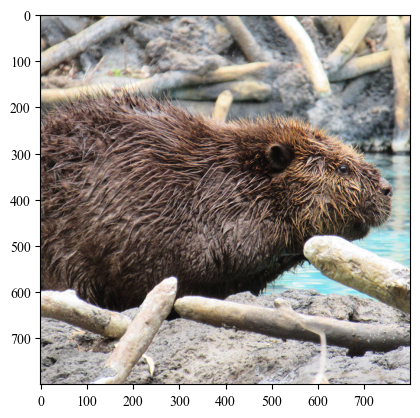

In [6]:
folder_path = '../Data/Things1854/'
image_path = folder_path + embeddings_baselin_seed1_epoch98['image'].values[0]
img = mpimg.imread(image_path)
plt.imshow(img);

Plot the final model embeddings.

In [7]:
path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_baselin_seed1_epoch98.columns = ['image'] + labels
embeddings_baselin_seed1_epoch98

,image,metallic/artificial\n,food-related\n,animal-related\n,textile\n,plant-related\n,house-related/furnishing-related\n,valuable/precious\n,transportation-/movement-related\n,body-/people-related\n,...,medicine-related / health-related\n,sweet / dessert-related\n,orange\n,thin / flat / wrapping\n,cylindrical / conical / cushioning\n,coldness-related / winter-related\n,measurement-related / numbers-related\n,fluffy / soft\n,masculine (stereotypical)\n,fine-grained pattern\n
1,beaver_01b.jpg,-2.791574,4.112199,83.05589,1.611154,9.45562,-0.477601,-3.145101,2.459847,7.721361,...,0.488741,0.202733,1.343291,-0.162403,0.317406,4.362388,2.097907,7.087073,2.322185,1.789866


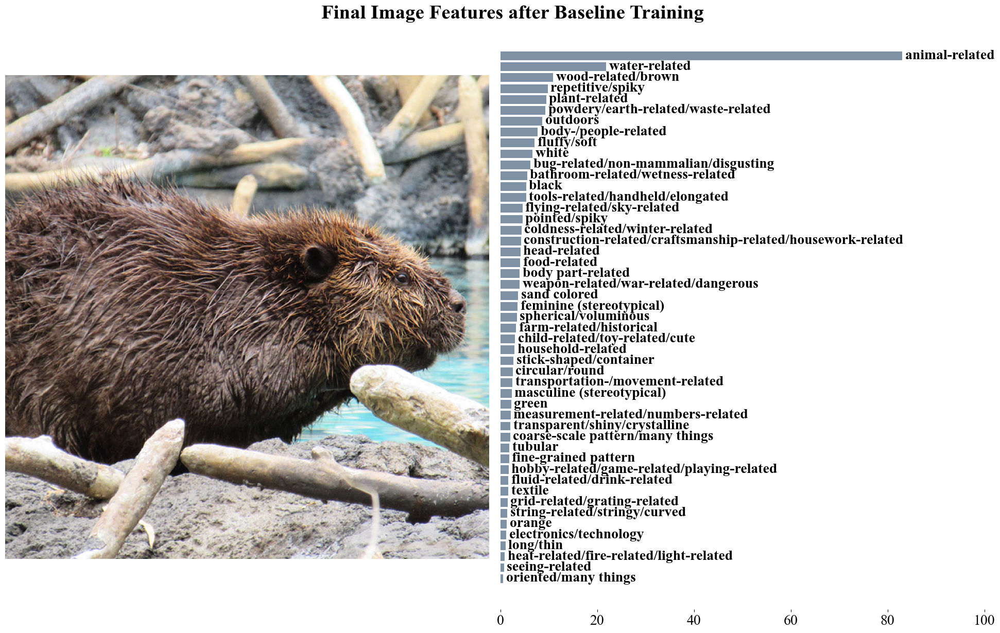

In [8]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
plt.rcParams['font.family'] = 'Times New Roman'

# Get the histogram of embeddings_baselin_seed1_epoch98['image'].iloc[0, 1:] ranked from top to bottom
histogram = embeddings_baselin_seed1_epoch98.iloc[0, 1:].sort_values(ascending=False).head(49).sort_values()
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Plot the histogram alongside the vertical right side of the image
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Final Image Features after Baseline Training", fontsize=28, fontweight='bold', fontname='Times New Roman', y=0.98)

# Create the bars with light blue color
bars = ax[1].barh(range(len(histogram)), histogram.values, color='#49637E', alpha = 0.7)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits to make room for the labels
ax[1].set_xlim(0, 100)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label) in enumerate(zip(histogram.values, histogram.index)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

# Set Times New Roman font for all text elements

plt.tight_layout()
# plt.show()
#plt.savefig(f'../figures/{model}_{object}.svg', format='svg', bbox_inches='tight', transparent=True)

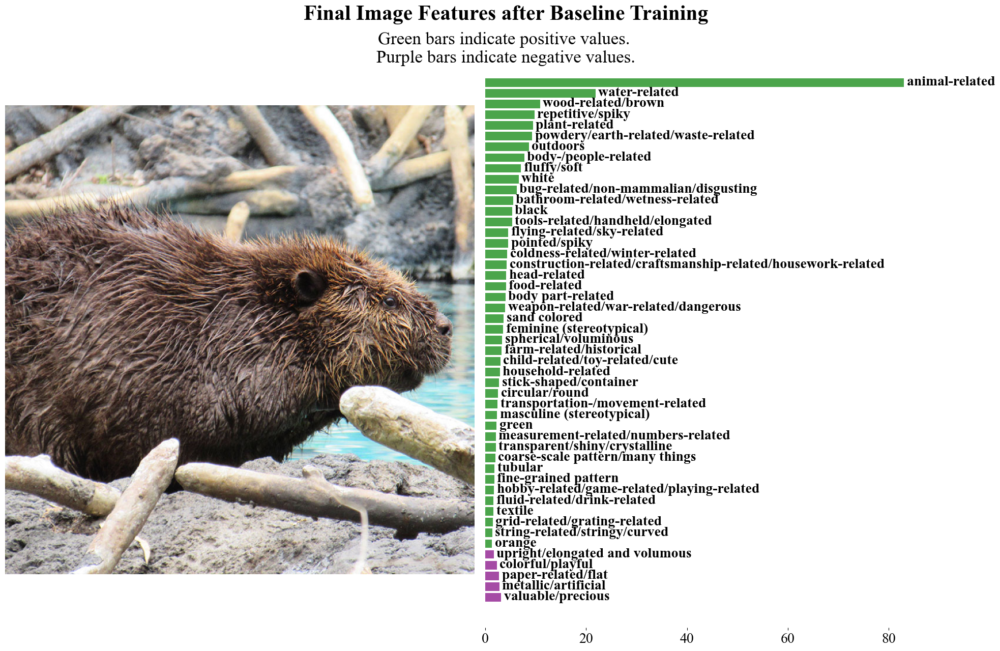

In [9]:
# Prepare histogram: get top 49 by absolute value of difference, preserve sign for coloring
diffs = embeddings_baselin_seed1_epoch98.iloc[0, 1:]
top_indices = diffs.abs().sort_values(ascending=False).head(49).index
histogram = diffs.loc[top_indices].sort_values()  # Sort for nice display
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors: green for positive, purple for negative (absolute value plotted for negative)
bar_colors = []
bar_values = []
for value in histogram.values:
    if value >= 0:
        bar_colors.append('#008000')  # Green
        bar_values.append(value)
    else:
        bar_colors.append('#800080')  # Purple
        bar_values.append(abs(value))

# Plot
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Final Image Features after Baseline Training", fontsize=30, fontweight='bold', fontname='Times New Roman', y=1.02)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.93,  # Lower y-value moves subtitle down
    "Green bars indicate positive values. \nPurple bars indicate negative values.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Plot the bars with color mapping and proper value handling
bars = ax[1].barh(
    range(len(bar_values)),
    bar_values,
    color=bar_colors,
    alpha=0.7,
)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits based on bar values for visibility, with small margin
max_value = max(bar_values) if bar_values else 1
ax[1].set_xlim(0, max_value * 1.12)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label, orig_value) in enumerate(zip(bar_values, histogram.index, histogram.values)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()

In [10]:
embeddings_sweep_seed42_epoch5_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run5/things_48_inference_results/things_48_embeddings_epoch86.csv'

embeddings_sweep_seed42_epoch5 = pd.read_csv(embeddings_sweep_seed42_epoch5_path)

# filter for the object row
embeddings_sweep_seed42_epoch5 = embeddings_sweep_seed42_epoch5[embeddings_sweep_seed42_epoch5['image'].str.contains(object)]

print(embeddings_sweep_seed42_epoch5)

            image         0         1         2         3         4         5  \
1  beaver_01b.jpg -1.225279  3.817481  82.76624  0.923308  8.917988 -0.581595   

          6         7         8  ...        56        57        58        59  \
1 -3.667896  3.082465  8.431677  ...  0.476411  0.345602  1.391758 -0.116662   

         60        61        62        63        64        65  
1 -0.245147  4.497263  2.069393  7.325577  2.756021  1.855035  

[1 rows x 67 columns]


In [11]:
path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_sweep_seed42_epoch5.columns = ['image'] + labels
embeddings_sweep_seed42_epoch5

,image,metallic/artificial\n,food-related\n,animal-related\n,textile\n,plant-related\n,house-related/furnishing-related\n,valuable/precious\n,transportation-/movement-related\n,body-/people-related\n,...,medicine-related / health-related\n,sweet / dessert-related\n,orange\n,thin / flat / wrapping\n,cylindrical / conical / cushioning\n,coldness-related / winter-related\n,measurement-related / numbers-related\n,fluffy / soft\n,masculine (stereotypical)\n,fine-grained pattern\n
1,beaver_01b.jpg,-1.225279,3.817481,82.76624,0.923308,8.917988,-0.581595,-3.667896,3.082465,8.431677,...,0.476411,0.345602,1.391758,-0.116662,-0.245147,4.497263,2.069393,7.325577,2.756021,1.855035


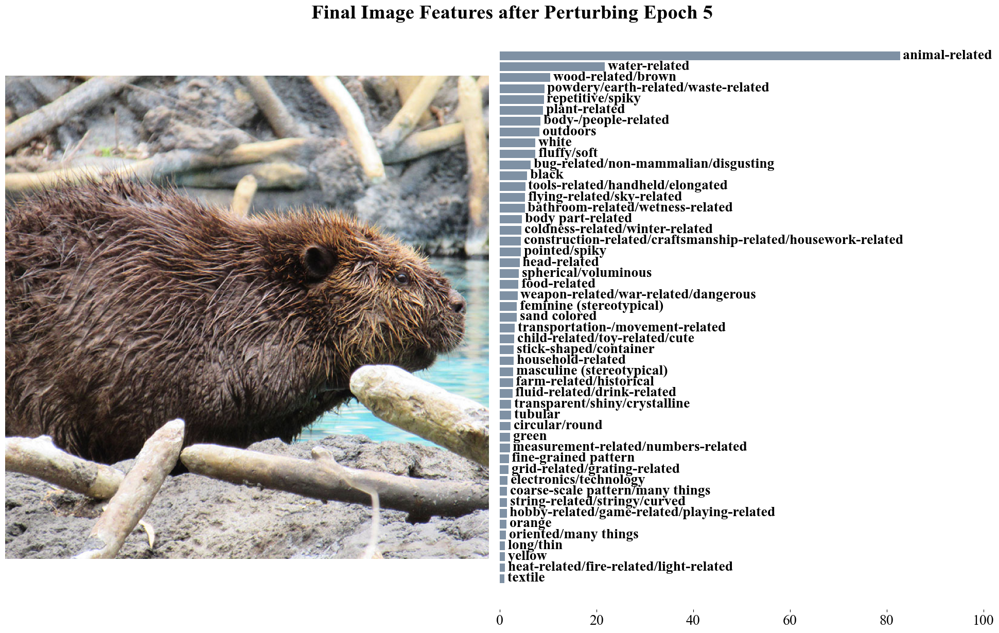

In [12]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
plt.rcParams['font.family'] = 'Times New Roman'

# Get the histogram of embeddings_sweep_seed42_epoch5['image'].iloc[0, 1:] ranked from top to bottom
histogram = embeddings_sweep_seed42_epoch5.iloc[0, 1:].sort_values(ascending=False).head(49).sort_values()
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Plot the histogram alongside the vertical right side of the image
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Final Image Features after Perturbing Epoch 5", fontsize=28, fontweight='bold', fontname='Times New Roman', y=0.98)

# Create the bars with light blue color
bars = ax[1].barh(range(len(histogram)), histogram.values, color='#49637E', alpha = 0.7)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits to make room for the labels
ax[1].set_xlim(0, 100)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label) in enumerate(zip(histogram.values, histogram.index)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()
# plt.show()
#plt.savefig(f'../figures/{model}_{object}.svg', format='svg', bbox_inches='tight', transparent=True)

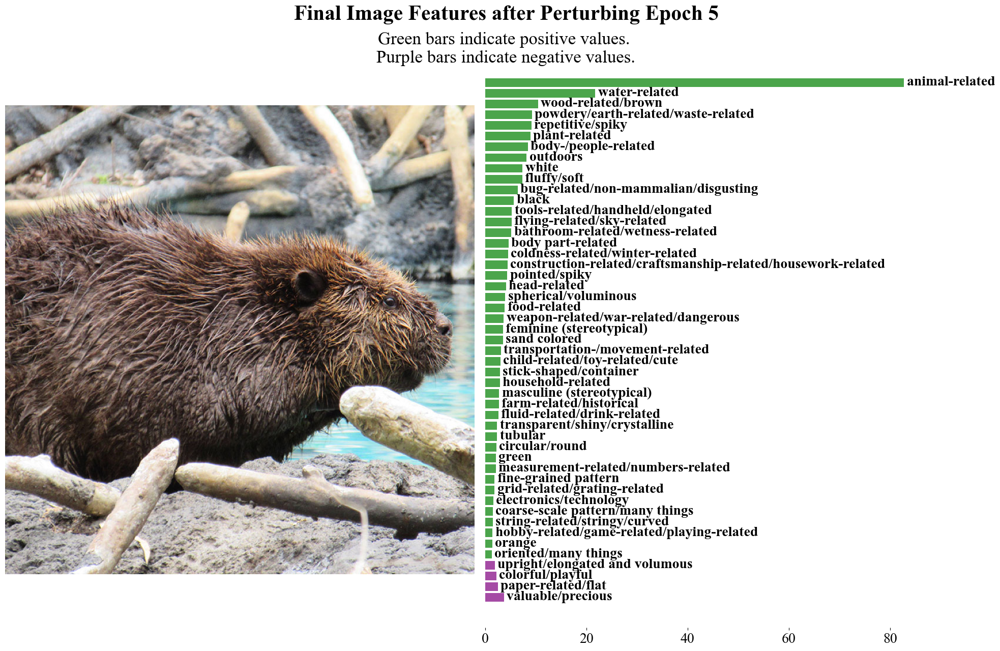

In [13]:
# Prepare histogram: get top 49 by absolute value of difference, preserve sign for coloring
diffs = embeddings_sweep_seed42_epoch5.iloc[0, 1:]
top_indices = diffs.abs().sort_values(ascending=False).head(49).index
histogram = diffs.loc[top_indices].sort_values()  # Sort for nice display
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors: green for positive, purple for negative (absolute value plotted for negative)
bar_colors = []
bar_values = []
for value in histogram.values:
    if value >= 0:
        bar_colors.append('#008000')  # Green
        bar_values.append(value)
    else:
        bar_colors.append('#800080')  # Purple
        bar_values.append(abs(value))

# Plot
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Final Image Features after Perturbing Epoch 5", fontsize=30, fontweight='bold', fontname='Times New Roman', y=1.02)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.93,  # Lower y-value moves subtitle down
    "Green bars indicate positive values. \nPurple bars indicate negative values.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Plot the bars with color mapping and proper value handling
bars = ax[1].barh(
    range(len(bar_values)),
    bar_values,
    color=bar_colors,
    alpha=0.7,
)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits based on bar values for visibility, with small margin
max_value = max(bar_values) if bar_values else 1
ax[1].set_xlim(0, max_value * 1.12)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label, orig_value) in enumerate(zip(bar_values, histogram.index, histogram.values)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()

In [14]:
embeddings_sweep_seed42_epoch50_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run50/things_48_inference_results/things_48_embeddings_epoch84.csv'

embeddings_sweep_seed42_epoch50 = pd.read_csv(embeddings_sweep_seed42_epoch50_path)

# filter for the object row
embeddings_sweep_seed42_epoch50 = embeddings_sweep_seed42_epoch50[embeddings_sweep_seed42_epoch50['image'].str.contains(object)]

print(embeddings_sweep_seed42_epoch50)

            image         0         1          2         3         4  \
1  beaver_01b.jpg -1.709439  4.456975  83.292435  1.615503  9.432842   

          5         6         7         8  ...        56        57        58  \
1 -1.302578 -3.022056  1.976256  7.859393  ...  0.011224 -0.491583  1.008754   

        59        60        61        62        63        64        65  
1 -0.68804 -0.696895  3.259979  1.296441  6.950209  2.095061  1.056986  

[1 rows x 67 columns]


In [15]:
path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_sweep_seed42_epoch50.columns = ['image'] + labels
embeddings_sweep_seed42_epoch50

,image,metallic/artificial\n,food-related\n,animal-related\n,textile\n,plant-related\n,house-related/furnishing-related\n,valuable/precious\n,transportation-/movement-related\n,body-/people-related\n,...,medicine-related / health-related\n,sweet / dessert-related\n,orange\n,thin / flat / wrapping\n,cylindrical / conical / cushioning\n,coldness-related / winter-related\n,measurement-related / numbers-related\n,fluffy / soft\n,masculine (stereotypical)\n,fine-grained pattern\n
1,beaver_01b.jpg,-1.709439,4.456975,83.292435,1.615503,9.432842,-1.302578,-3.022056,1.976256,7.859393,...,0.011224,-0.491583,1.008754,-0.68804,-0.696895,3.259979,1.296441,6.950209,2.095061,1.056986


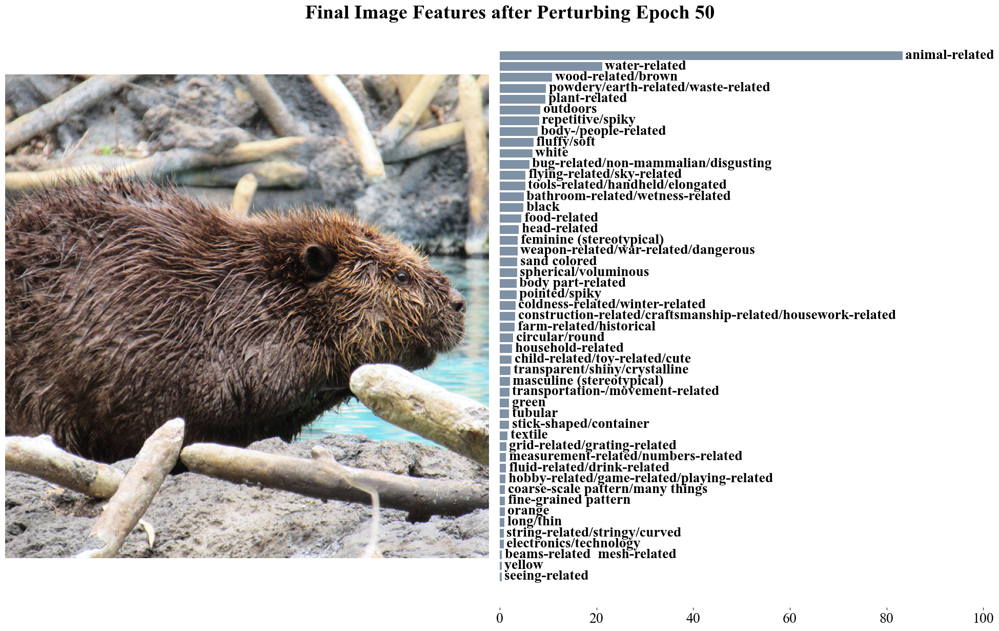

In [16]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
plt.rcParams['font.family'] = 'Times New Roman'

# Get the histogram of embeddings_sweep_seed42_epoch50['image'].iloc[0, 1:] ranked from top to bottom
histogram = embeddings_sweep_seed42_epoch50.iloc[0, 1:].sort_values(ascending=False).head(49).sort_values()
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Plot the histogram alongside the vertical right side of the image
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Final Image Features after Perturbing Epoch 50", fontsize=28, fontweight='bold', fontname='Times New Roman', y=0.98)

# Create the bars with light blue color
bars = ax[1].barh(range(len(histogram)), histogram.values, color='#49637E', alpha = 0.7)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits to make room for the labels
ax[1].set_xlim(0, 100)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label) in enumerate(zip(histogram.values, histogram.index)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()
# plt.show()
#plt.savefig(f'../figures/{model}_{object}.svg', format='svg', bbox_inches='tight', transparent=True)

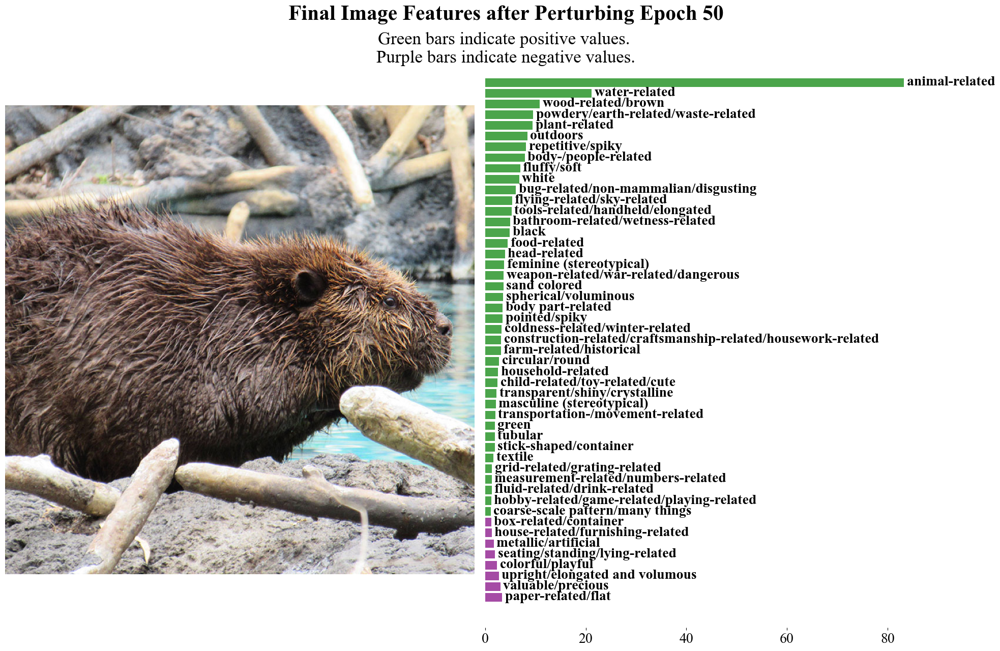

In [17]:
# Prepare histogram: get top 49 by absolute value of difference, preserve sign for coloring
diffs = embeddings_sweep_seed42_epoch50.iloc[0, 1:]
top_indices = diffs.abs().sort_values(ascending=False).head(49).index
histogram = diffs.loc[top_indices].sort_values()  # Sort for nice display
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors: green for positive, purple for negative (absolute value plotted for negative)
bar_colors = []
bar_values = []
for value in histogram.values:
    if value >= 0:
        bar_colors.append('#008000')  # Green
        bar_values.append(value)
    else:
        bar_colors.append('#800080')  # Purple
        bar_values.append(abs(value))

# Plot
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Final Image Features after Perturbing Epoch 50", fontsize=30, fontweight='bold', fontname='Times New Roman', y=1.02)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.93,  # Lower y-value moves subtitle down
    "Green bars indicate positive values. \nPurple bars indicate negative values.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Plot the bars with color mapping and proper value handling
bars = ax[1].barh(
    range(len(bar_values)),
    bar_values,
    color=bar_colors,
    alpha=0.7,
)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits based on bar values for visibility, with small margin
max_value = max(bar_values) if bar_values else 1
ax[1].set_xlim(0, max_value * 1.12)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label, orig_value) in enumerate(zip(bar_values, histogram.index, histogram.values)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()

Plot the difference between embedding at the epoch of perturbation.

In [18]:
embeddings_baseline_seed1_epoch5_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results/things_48_embeddings_epoch5.csv'

embeddings_baseline_seed1_epoch5 = pd.read_csv(embeddings_baseline_seed1_epoch5_path)

# filter for the object row
embeddings_baseline_seed1_epoch5 = embeddings_baseline_seed1_epoch5[embeddings_baseline_seed1_epoch5['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_baseline_seed1_epoch5.columns = ['image'] + labels  

print(embeddings_baseline_seed1_epoch5)

            image  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg               18.13934        9.141707          18.29786   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1   6.035485          5.57246                            3.036769   

   valuable/precious\n  transportation-/movement-related\n  \
1             4.673027                            4.972112   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1                3.887755  ...                            -2.761522   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
1                  -0.417741  0.847432                 -6.683374   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                             -2.759674                             0.037508   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                -2.013994         7.995097   

   masculin

In [19]:
embeddings_sweep_seed42_epoch5_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run5/things_48_inference_results/things_48_embeddings_epoch86.csv'

embeddings_sweep_seed42_epoch5 = pd.read_csv(embeddings_sweep_seed42_epoch5_path)

# filter for the object row
embeddings_sweep_seed42_epoch5 = embeddings_sweep_seed42_epoch5[embeddings_sweep_seed42_epoch5['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_sweep_seed42_epoch5.columns = ['image'] + labels

print(embeddings_sweep_seed42_epoch5)

            image  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg              -1.225279        3.817481          82.76624   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1   0.923308         8.917988                           -0.581595   

   valuable/precious\n  transportation-/movement-related\n  \
1            -3.667896                            3.082465   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1                8.431677  ...                             0.476411   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
1                   0.345602  1.391758                 -0.116662   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                             -0.245147                             4.497263   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                 2.069393         7.325577   

   masculin

In [20]:
# Subtract numeric columns: embeddings_sweep_seed42_epoch5 - embeddings_baseline_seed1_epoch5
# Select only numeric columns (exclude 'image')
numeric_cols = [col for col in embeddings_sweep_seed42_epoch5.columns if col != 'image']
embedding_diff = embeddings_sweep_seed42_epoch5[numeric_cols] - embeddings_baseline_seed1_epoch5[numeric_cols]

# Create result dataframe with 'image' column and differences
embedding_epoch5_diff_result = pd.DataFrame()
embedding_epoch5_diff_result['image'] = embeddings_sweep_seed42_epoch5['image']
embedding_epoch5_diff_result = pd.concat([embedding_epoch5_diff_result, embedding_diff], axis=1)

embedding_epoch5_diff_result


,image,metallic/artificial\n,food-related\n,animal-related\n,textile\n,plant-related\n,house-related/furnishing-related\n,valuable/precious\n,transportation-/movement-related\n,body-/people-related\n,...,medicine-related / health-related\n,sweet / dessert-related\n,orange\n,thin / flat / wrapping\n,cylindrical / conical / cushioning\n,coldness-related / winter-related\n,measurement-related / numbers-related\n,fluffy / soft\n,masculine (stereotypical)\n,fine-grained pattern\n
1,beaver_01b.jpg,-19.364619,-5.324226,64.46838,-5.112177,3.345528,-3.618364,-8.340924,-1.889647,4.543922,...,3.237933,0.763343,0.544326,6.566712,2.514527,4.459756,4.083387,-0.66952,4.38184,4.453259


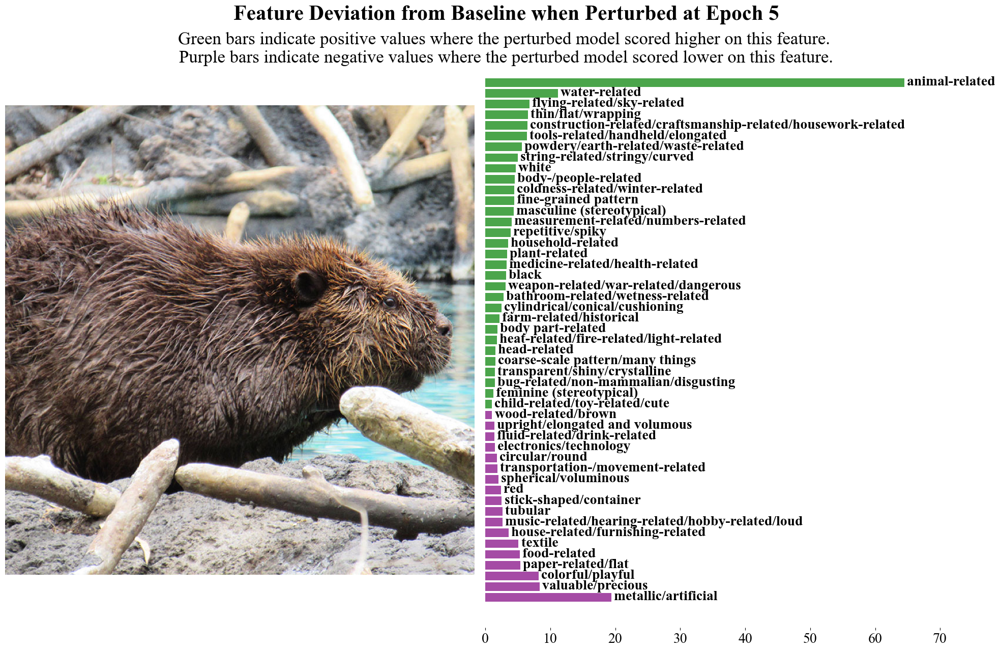

In [21]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
plt.rcParams['font.family'] = 'Times New Roman'

# Prepare histogram: get top 49 by absolute value of difference, preserve sign for coloring
diffs = embedding_epoch5_diff_result.iloc[0, 1:]
top_indices = diffs.abs().sort_values(ascending=False).head(49).index
histogram = diffs.loc[top_indices].sort_values()  # Sort for nice display
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors: green for positive, purple for negative (absolute value plotted for negative)
bar_colors = []
bar_values = []
for value in histogram.values:
    if value >= 0:
        bar_colors.append('#008000')  # Green
        bar_values.append(value)
    else:
        bar_colors.append('#800080')  # Purple
        bar_values.append(abs(value))

# Plot
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Feature Deviation from Baseline when Perturbed at Epoch 5", fontsize=30, fontweight='bold', fontname='Times New Roman', y=1.02)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.93,  # Lower y-value moves subtitle down
    "Green bars indicate positive values where the perturbed model scored higher on this feature. \nPurple bars indicate negative values where the perturbed model scored lower on this feature.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Plot the bars with color mapping and proper value handling
bars = ax[1].barh(
    range(len(bar_values)),
    bar_values,
    color=bar_colors,
    alpha=0.7,
)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits based on bar values for visibility, with small margin
max_value = max(bar_values) if bar_values else 1
ax[1].set_xlim(0, max_value * 1.12)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label, orig_value) in enumerate(zip(bar_values, histogram.index, histogram.values)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()
# plt.show()
#plt.savefig(f'../figures/{model}_{object}.svg', format='svg', bbox_inches='tight', transparent=True)

Visualize features to see if there's permanent harm to the feature.

In [22]:
embeddings_baseline_seed1_epoch50_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results/things_48_embeddings_epoch50.csv'

embeddings_baseline_seed1_epoch50 = pd.read_csv(embeddings_baseline_seed1_epoch50_path)

# filter for the object row
embeddings_baseline_seed1_epoch50 = embeddings_baseline_seed1_epoch50[embeddings_baseline_seed1_epoch50['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_baseline_seed1_epoch50.columns = ['image'] + labels  

print(embeddings_baseline_seed1_epoch50)

            image  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg              -5.476815        8.180667         78.907814   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1   1.714629         9.670764                            0.949091   

   valuable/precious\n  transportation-/movement-related\n  \
1            -4.977563                            0.776488   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1                8.003532  ...                            -0.768913   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
1                  -0.423571  2.324753                 -2.028714   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                              0.868821                             3.327828   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                 1.277346         7.060898   

   masculin

In [23]:
embeddings_sweep_seed42_epoch50_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run50/things_48_inference_results/things_48_embeddings_epoch50.csv'

embeddings_sweep_seed42_epoch50 = pd.read_csv(embeddings_sweep_seed42_epoch50_path)

# filter for the object row
embeddings_sweep_seed42_epoch50 = embeddings_sweep_seed42_epoch50[embeddings_sweep_seed42_epoch50['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
embeddings_sweep_seed42_epoch50.columns = ['image'] + labels

print(embeddings_sweep_seed42_epoch50)

            image  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg               3.687778        2.562181          8.198084   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1   5.059706         4.288946                            5.045727   

   valuable/precious\n  transportation-/movement-related\n  \
1             3.722323                             5.04301   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1                4.319643  ...                             5.513716   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
1                   5.245197  5.294666                  5.661376   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                              4.926483                             4.248028   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                  4.76926         6.469507   

   masculin

In [24]:
# Subtract numeric columns: embeddings_sweep_seed42_epoch50 - embeddings_baseline_seed1_epoch50
# Select only numeric columns (exclude 'image')
numeric_cols = [col for col in embeddings_sweep_seed42_epoch50.columns if col != 'image']
embedding_diff = embeddings_sweep_seed42_epoch50[numeric_cols] - embeddings_baseline_seed1_epoch50[numeric_cols]

# Create result dataframe with 'image' column and differences
embedding_epoch50_diff_result = pd.DataFrame()
embedding_epoch50_diff_result['image'] = embeddings_sweep_seed42_epoch50['image']
embedding_epoch50_diff_result = pd.concat([embedding_epoch50_diff_result, embedding_diff], axis=1)

embedding_epoch50_diff_result

,image,metallic/artificial\n,food-related\n,animal-related\n,textile\n,plant-related\n,house-related/furnishing-related\n,valuable/precious\n,transportation-/movement-related\n,body-/people-related\n,...,medicine-related / health-related\n,sweet / dessert-related\n,orange\n,thin / flat / wrapping\n,cylindrical / conical / cushioning\n,coldness-related / winter-related\n,measurement-related / numbers-related\n,fluffy / soft\n,masculine (stereotypical)\n,fine-grained pattern\n
1,beaver_01b.jpg,9.164593,-5.618486,-70.70973,3.345077,-5.381818,4.096636,8.699886,4.266522,-3.683889,...,6.282629,5.668768,2.969913,7.69009,4.057662,0.9202,3.491914,-0.591392,3.045161,4.426099


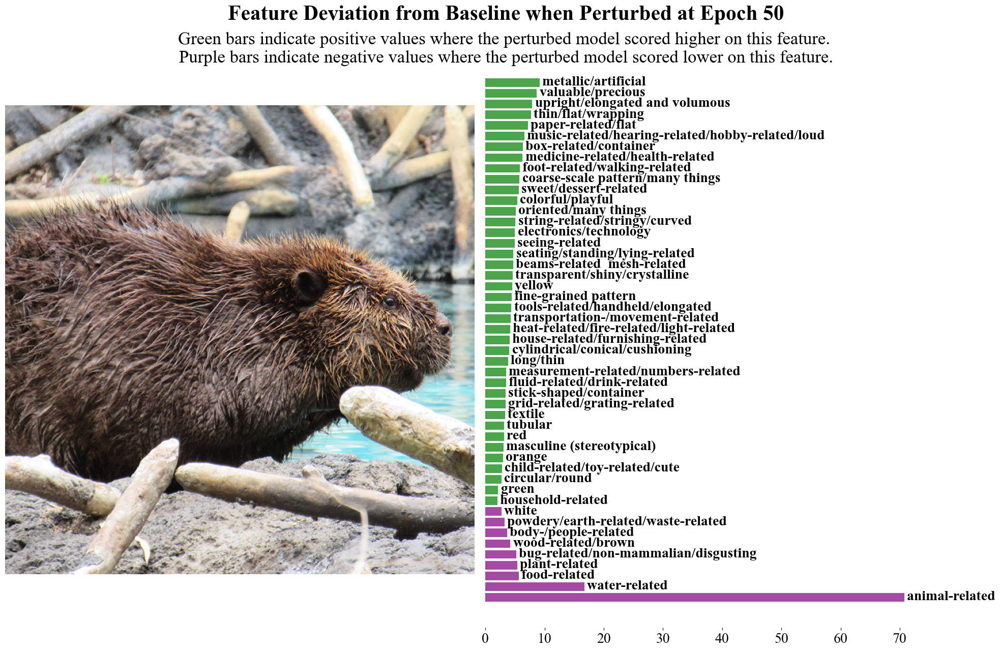

In [25]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
plt.rcParams['font.family'] = 'Times New Roman'

# Prepare histogram: get top 49 by absolute value of difference, preserve sign for coloring
diffs = embedding_epoch50_diff_result.iloc[0, 1:]
top_indices = diffs.abs().sort_values(ascending=False).head(49).index
histogram = diffs.loc[top_indices].sort_values()  # Sort for nice display
histogram.index = histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors: green for positive, purple for negative (absolute value plotted for negative)
bar_colors = []
bar_values = []
for value in histogram.values:
    if value >= 0:
        bar_colors.append('#008000')  # Green
        bar_values.append(value)
    else:
        bar_colors.append('#800080')  # Purple
        bar_values.append(abs(value))

# Plot
fig, ax = plt.subplots(1, 2, figsize=(20, 12.5))  # Adjusted figsize for better fit

ax[0].imshow(img)
ax[0].axis('off')

# Add a title above the bar chart
fig.suptitle("Feature Deviation from Baseline when Perturbed at Epoch 50", fontsize=30, fontweight='bold', fontname='Times New Roman', y=1.02)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.93,  # Lower y-value moves subtitle down
    "Green bars indicate positive values where the perturbed model scored higher on this feature. \nPurple bars indicate negative values where the perturbed model scored lower on this feature.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Plot the bars with color mapping and proper value handling
bars = ax[1].barh(
    range(len(bar_values)),
    bar_values,
    color=bar_colors,
    alpha=0.7,
)

# Turn off the current y-axis labels
ax[1].set_yticks([])
ax[1].tick_params(axis='x', labelsize=20)

# Set x-axis limits based on bar values for visibility, with small margin
max_value = max(bar_values) if bar_values else 1
ax[1].set_xlim(0, max_value * 1.12)

# Loop through the bars and add the y-axis labels to the right, slightly shifted down
for i, (value, label, orig_value) in enumerate(zip(bar_values, histogram.index, histogram.values)):
    ax[1].text(value-0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')

# Remove the outer frame of the bar plot
for spine in ax[1].spines.values():
    spine.set_visible(False)

# Set the figure background color to be transparent
fig.patch.set_alpha(0)

# Set the axes background color to be transparent
ax[0].set_facecolor('none')
ax[1].set_facecolor('none')

plt.tight_layout()
# plt.show()
#plt.savefig(f'../figures/{model}_{object}.svg', format='svg', bbox_inches='tight', transparent=True)

In [26]:
# get the target embedding for the image

# path to target
target_embedding_path = Path('../Data/spose_embedding66d_rescaled_48val_reordered.csv')

target_embedding = pd.read_csv(target_embedding_path)

# Remove the 'Unnamed' column if it exists
target_embedding = target_embedding.loc[:, ~target_embedding.columns.str.contains('^Unnamed')]

target_embedding = target_embedding[target_embedding['image_name'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
target_embedding.columns = ['image_name'] + labels

print(target_embedding)

       image_name  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg               1.351147        3.982135         91.049569   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1   0.348649         8.929281                            0.727055   

   valuable/precious\n  transportation-/movement-related\n  \
1             1.539169                            1.017233   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1                4.268899  ...                             0.835306   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
1                   1.310193  0.634133                  1.074213   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                               1.59009                             0.353474   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                 0.348709         6.902653   

   masculin

In [27]:
# read in the baseline model at epoch 5

embeddings_baselin_seed1_epoch5_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results/things_48_embeddings_epoch5.csv'

embeddings_baselin_seed1_epoch5 = pd.read_csv(embeddings_baselin_seed1_epoch5_path)

# min-max normalize the embeddings 0 to 100
# Select only numeric columns (exclude 'image')
numeric_cols = [col for col in embeddings_baselin_seed1_epoch5.columns if col != 'image']
min_val = np.min(embeddings_baselin_seed1_epoch5[numeric_cols].values)
max_val = np.max(embeddings_baselin_seed1_epoch5[numeric_cols].values)

normalized_embeddings_baselin_seed1_epoch5 = embeddings_baselin_seed1_epoch5.copy()
normalized_embeddings_baselin_seed1_epoch5[numeric_cols] = 100 * (embeddings_baselin_seed1_epoch5[numeric_cols] - min_val) / (max_val - min_val)

# filter for the object row
normalized_embeddings_baselin_seed1_epoch5 = normalized_embeddings_baselin_seed1_epoch5[normalized_embeddings_baselin_seed1_epoch5['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
normalized_embeddings_baselin_seed1_epoch5.columns = ['image_name'] + labels

print(normalized_embeddings_baselin_seed1_epoch5)

# get the embedding values
#embeddings_baselin_seed1_epoch98_values = embeddings_baselin_seed1_epoch98.values


       image_name  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg              78.137906       49.814806         78.636901   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1  40.036919         38.57939                           30.597444   

   valuable/precious\n  transportation-/movement-related\n  \
1            35.748122                           36.689592   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1               33.276212  ...                            12.345357   

   sweet / dessert-related\n   orange\n  thin / flat / wrapping\n  \
1                  19.723202  23.705763                       0.0   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                             12.351175                            21.156251   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                14.698455        46.205462   

   mascul

In [28]:
# Calculate each feature in embeddings_baselin_seed1_epoch5 as a percent of the corresponding feature in target_embedding
# Select only numeric columns from each dataframe (exclude 'image'/'image_name')
numeric_cols_baseline = [col for col in normalized_embeddings_baselin_seed1_epoch5.columns if col != 'image' and col != 'image_name']
numeric_cols_target = [col for col in target_embedding.columns if col != 'image_name']

# Get numeric values as arrays (align by position, not column name)
baseline_values = normalized_embeddings_baselin_seed1_epoch5[numeric_cols_baseline].values
target_values = target_embedding[numeric_cols_target].values

print(baseline_values.shape)
print(target_values.shape)

print(baseline_values)
print(target_values)


(1, 66)
(1, 66)
[[78.1379056  49.81480555 78.63690104 40.0369188  38.5793897  30.59744426
  35.74812195 36.6895918  33.27621181 57.17798815 30.53626223 40.0266814
  44.64950552 33.63119235 30.20844943 28.63292894 17.32004351 33.65708962
  54.32231268 25.99425006 32.39406109 29.48909046 20.97176229 28.22356066
  22.94458316 22.73952858 28.74578148 18.94989539 28.28022176 29.67962066
  36.7233785  28.04806171 25.73760675 37.58531568 14.45463681 39.7895251
   9.9831951  17.00139344 16.0441249  36.52504167 23.69534641 33.39231859
  26.23991497 28.43494907 22.29179583 18.56784626 22.21612902 16.95176272
  18.74023294 38.03888151 29.05832916 19.50232823 34.95075702 27.28982756
  22.74774614 22.70943902 12.3453571  19.72320195 23.70576293  0.
  12.35117493 21.15625147 14.69845489 46.20546188 15.92036918 12.85939102]]
[[ 1.35114719  3.98213523 91.04956895  0.34864915  8.92928084  0.72705507
   1.53916935  1.01723317  4.26889861 19.96548966  0.21406406  1.2070335
  12.78278094  4.37700885  0.27

In [29]:
eps = 1e-8

baseline_embedding_ratio = np.log2((baseline_values + eps) / (target_values + eps))

baseline_embedding_ratio_result = pd.DataFrame(
    baseline_embedding_ratio,
    columns=numeric_cols_target
)
baseline_embedding_ratio_result.insert(0, 'image_name', normalized_embeddings_baselin_seed1_epoch5['image_name'].values)

print(baseline_embedding_ratio_result)

       image_name  metallic/artificial\n  food-related\n  animal-related\n  \
0  beaver_01b.jpg               5.853766         3.64496         -0.211446   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
0   6.843411         2.111214                            5.395203   

   valuable/precious\n  transportation-/movement-related\n  \
0             4.537644                            5.172649   

   body-/people-related\n  ...  medicine-related / health-related\n  \
0                2.962555  ...                              3.88552   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
0                   3.912042  5.224309                -26.678705   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
0                              2.957468                             5.903337   

   measurement-related / numbers-related\n  fluffy / soft\n  \
0                                 5.397497          2.74284   

   masculin

In [30]:
baseline_diff = normalized_embeddings_baselin_seed1_epoch5.iloc[0, 1:] - target_embedding.iloc[0, 1:]

print(baseline_diff)

metallic/artificial\n                      76.786758
food-related\n                              45.83267
animal-related\n                          -12.412668
textile\n                                   39.68827
plant-related\n                            29.650109
                                             ...    
coldness-related / winter-related\n        20.802778
measurement-related / numbers-related\n    14.349746
fluffy / soft\n                            39.302809
masculine (stereotypical)\n                15.242126
fine-grained pattern\n                     11.960514
Name: 1, Length: 66, dtype: object


In [31]:
# read in the embedding at the perturbed epoch 5

embeddings_sweep_seed42_epoch5_path = '/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run5/things_48_inference_results/things_48_embeddings_epoch5.csv'

embeddings_sweep_seed42_epoch5 = pd.read_csv(embeddings_sweep_seed42_epoch5_path)

# min-max normalize the embeddings 0 to 100
# Select only numeric columns (exclude 'image')
numeric_cols = [col for col in embeddings_sweep_seed42_epoch5.columns if col != 'image']
min_val = np.min(embeddings_sweep_seed42_epoch5[numeric_cols].values)
max_val = np.max(embeddings_sweep_seed42_epoch5[numeric_cols].values)

normalized_embeddings_sweep_seed42_epoch5 = embeddings_sweep_seed42_epoch5.copy()
normalized_embeddings_sweep_seed42_epoch5[numeric_cols] = 100 * (embeddings_sweep_seed42_epoch5[numeric_cols] - min_val) / (max_val - min_val)

# filter for the object row
normalized_embeddings_sweep_seed42_epoch5 = normalized_embeddings_sweep_seed42_epoch5[normalized_embeddings_sweep_seed42_epoch5['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
normalized_embeddings_sweep_seed42_epoch5.columns = ['image_name'] + labels

print(normalized_embeddings_sweep_seed42_epoch5)

# get the embedding values
#embeddings_baselin_seed1_epoch98_values = embeddings_baselin_seed1_epoch98.values

       image_name  metallic/artificial\n  food-related\n  animal-related\n  \
1  beaver_01b.jpg              37.549535         33.2789         55.833587   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
1  21.693138        20.647282                            24.97515   

   valuable/precious\n  transportation-/movement-related\n  \
1            31.434244                           31.392918   

   body-/people-related\n  ...  medicine-related / health-related\n  \
1               24.194891  ...                            14.123474   

   sweet / dessert-related\n   orange\n  thin / flat / wrapping\n  \
1                  18.540335  33.386903                  6.417531   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
1                             26.622833                            33.067617   

   measurement-related / numbers-related\n  fluffy / soft\n  \
1                                27.873769        55.151119   

   mascul

In [32]:
# Calculate each feature in embeddings_baselin_seed1_epoch5 as a percent of the corresponding feature in target_embedding
# Select only numeric columns from each dataframe (exclude 'image'/'image_name')
numeric_cols_baseline = [col for col in normalized_embeddings_sweep_seed42_epoch5.columns if col != 'image' and col != 'image_name']
numeric_cols_target = [col for col in target_embedding.columns if col != 'image_name']

# Get numeric values as arrays (align by position, not column name)
sweep_values = normalized_embeddings_sweep_seed42_epoch5[numeric_cols_baseline].values
target_values = target_embedding[numeric_cols_target].values

print(sweep_values.shape)
print(target_values.shape)

print(sweep_values)
print(target_values)

(1, 66)
(1, 66)
[[37.54953491 33.27889991 55.83358709 21.69313754 20.64728231 24.9751496
  31.43424392 31.39291803 24.19489135 49.69252996 16.55092032 32.89674842
  39.70942822 26.84153643 23.65878541 26.03644415 12.12123447 34.50110097
  50.30982098 25.51622244 31.74306376 27.56893578 26.38653849 26.01909676
  24.67223029 22.7711532  27.19943483 17.55129394 23.73623247 34.88110507
  36.23828022 28.71187039 31.45752207 44.00994377 28.79568001 48.03401254
  22.71626682 25.0063225  14.9358535  43.15813093 24.00613127 36.48544654
  28.14177808 41.4975815  25.90340785 25.84533666 31.57433758 20.01043806
  23.51680283 48.70557273 34.93917424 25.97154687 37.41858554 28.76866584
  16.3361966  31.04323281 14.12347411 18.54033507 33.38690266  6.41753077
  26.62283334 33.06761745 27.8737692  55.15111865 22.86176876 13.09055561]]
[[ 1.35114719  3.98213523 91.04956895  0.34864915  8.92928084  0.72705507
   1.53916935  1.01723317  4.26889861 19.96548966  0.21406406  1.2070335
  12.78278094  4.37700

In [33]:
eps = 1e-8

sweep_embedding_ratio = np.log2(sweep_values + eps / (target_values + eps))

sweep_embedding_ratio_result = pd.DataFrame(
    sweep_embedding_ratio,
    columns=numeric_cols_target
)
sweep_embedding_ratio_result.insert(0, 'image_name', normalized_embeddings_sweep_seed42_epoch5['image_name'].values)

print(sweep_embedding_ratio_result)

       image_name  metallic/artificial\n  food-related\n  animal-related\n  \
0  beaver_01b.jpg               5.230723        5.056536          5.803061   

   textile\n  plant-related\n  house-related/furnishing-related\n  \
0   4.439167          4.36788                            4.642421   

   valuable/precious\n  transportation-/movement-related\n  \
0             4.974265                            4.972367   

   body-/people-related\n  ...  medicine-related / health-related\n  \
0                4.596631  ...                             3.820023   

   sweet / dessert-related\n  orange\n  thin / flat / wrapping\n  \
0                   4.212595   5.06121                  2.682018   

   cylindrical / conical / cushioning\n  coldness-related / winter-related\n  \
0                              4.734592                             5.047347   

   measurement-related / numbers-related\n  fluffy / soft\n  \
0                                 4.800836         5.785318   

   masculin

In [34]:
sweep_diff = normalized_embeddings_sweep_seed42_epoch5.iloc[0, 1:] - target_embedding.iloc[0, 1:]

print(sweep_diff)

metallic/artificial\n                      36.198388
food-related\n                             29.296765
animal-related\n                          -35.215982
textile\n                                  21.344488
plant-related\n                            11.718001
                                             ...    
coldness-related / winter-related\n        32.714144
measurement-related / numbers-related\n     27.52506
fluffy / soft\n                            48.248465
masculine (stereotypical)\n                22.183525
fine-grained pattern\n                     12.191678
Name: 1, Length: 66, dtype: object


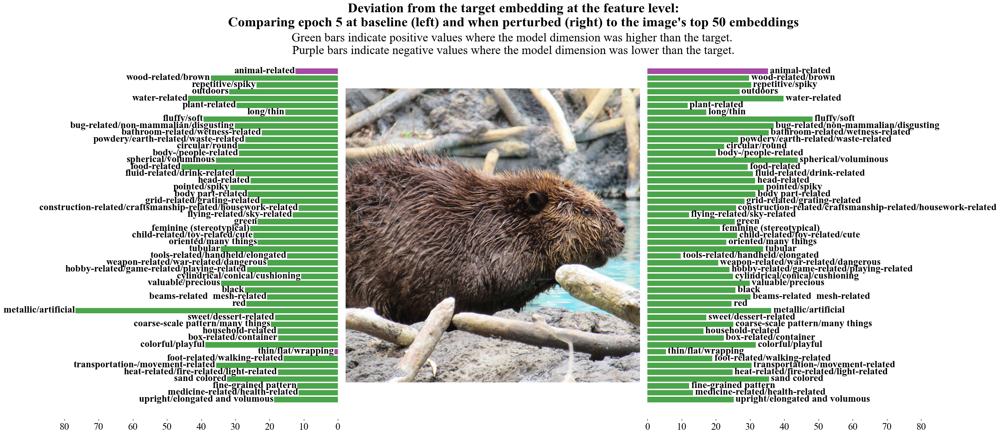

In [35]:
# Load image
folder_path = '../Data/Things1854/'
image_path = folder_path + target_embedding['image_name'].values[0]
img = mpimg.imread(image_path)

# Load labels
label_path = '../Data/labels66.txt'
with open(label_path) as f:
    labels = f.readlines()

# baseline_diff and sweep_diff are Series (from iloc[0, 1:]), so rename their index
baseline_diff.index = labels
sweep_diff.index = labels

# Sort the target embedding values and get their indices to use as reference order (top = largest values)
target_sorted_indices = target_embedding.iloc[0, 1:].sort_values(ascending=False).head(49).index

# To ensure highest values are at the TOP of the histogram, reverse the order:
target_sorted_indices = target_sorted_indices[::-1]

# Use this order for both baseline and sweep percent results
baseline_diff_histogram = baseline_diff.loc[target_sorted_indices]
sweep_diff_histogram = sweep_diff.loc[target_sorted_indices]

# Format labels
baseline_diff_histogram.index = baseline_diff_histogram.index.str.replace(" / ", "/", regex=False)
sweep_diff_histogram.index = sweep_diff_histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors and absolute values for baseline (left plot)
baseline_bar_colors = []
baseline_bar_values = []
for value in baseline_diff_histogram.values:
    if value >= 0:
        baseline_bar_colors.append('#008000')  # Green
        baseline_bar_values.append(abs(value))
    else:
        baseline_bar_colors.append('#800080')  # Purple
        baseline_bar_values.append(abs(value))

# Determine colors and absolute values for sweep (right plot)
sweep_bar_colors = []
sweep_bar_values = []
for value in sweep_diff_histogram.values:
    if value >= 0:
        sweep_bar_colors.append('#008000')  # Green
        sweep_bar_values.append(abs(value))
    else:
        sweep_bar_colors.append('#800080')  # Purple
        sweep_bar_values.append(abs(value))

# Find the global max absolute value to set same scale on both axes
global_max = max(
    max(baseline_bar_values) if baseline_bar_values else 0,
    max(sweep_bar_values) if sweep_bar_values else 0
)

# Buffer factor; should match visual proportion in original code
xlim_val = global_max * 1.12 if global_max != 0 else 100

fig, ax = plt.subplots(1, 3, figsize=(30, 12), gridspec_kw={'width_ratios': [1, 1, 1]})

# Left-side mirrored bar plot (baseline) - plot absolute values with color coding
ax[0].barh(range(len(baseline_bar_values)), baseline_bar_values, color=baseline_bar_colors, alpha=0.7)
ax[0].invert_xaxis()  # Flip the x-axis to go from max to 0
ax[0].set_xlim(xlim_val, 0)   # Set left axis to match right axis scale
ax[0].set_yticks([])
ax[0].tick_params(axis='x', labelsize=20)
for i, (value, label, orig_value) in enumerate(zip(baseline_bar_values, baseline_diff_histogram.index, baseline_diff_histogram.values)):
    ax[0].text(value + 0.15, i - 0.65, f'{label} ', va='center', ha='right', fontsize=20, fontweight='bold')
for spine in ax[0].spines.values():
    spine.set_visible(False)
ax[0].set_facecolor('none')

# Center image
ax[1].imshow(img)
ax[1].axis('off')
ax[1].set_facecolor('none')

# Right-side bar plot (sweep) - plot absolute values with color coding
ax[2].barh(range(len(sweep_bar_values)), sweep_bar_values, color=sweep_bar_colors, alpha=0.7)
ax[2].set_xlim(0, xlim_val)   # Axis scale matches left
ax[2].set_yticks([])
ax[2].tick_params(axis='x', labelsize=20)
for i, (value, label, orig_value) in enumerate(zip(sweep_bar_values, sweep_diff_histogram.index, sweep_diff_histogram.values)):
    ax[2].text(value - 0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')
for spine in ax[2].spines.values():
    spine.set_visible(False)
ax[2].set_facecolor('none')

# Set figure transparency
fig.patch.set_alpha(0)

fig.suptitle('Deviation from the target embedding at the feature level:\nComparing epoch 5 at baseline (left) and when perturbed (right) to the image\'s top 50 embeddings', fontsize=28, fontweight='bold', y=1.03)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.91,  # Lower y-value moves subtitle down
    "Green bars indicate positive values where the model dimension was higher than the target. \nPurple bars indicate negative values where the model dimension was lower than the target.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Adjust layout
plt.tight_layout()

# Save the figure
plt.savefig(f'../figures/{object}_vit_vs_hba.svg', format='svg', bbox_inches='tight', transparent=True)


metallic/artificial\n                      76.786758
food-related\n                              45.83267
animal-related\n                          -12.412668
textile\n                                   39.68827
plant-related\n                            29.650109
                                             ...    
coldness-related / winter-related\n        20.802778
measurement-related / numbers-related\n    14.349746
fluffy / soft\n                            39.302809
masculine (stereotypical)\n                15.242126
fine-grained pattern\n                     11.960514
Name: 1, Length: 66, dtype: object


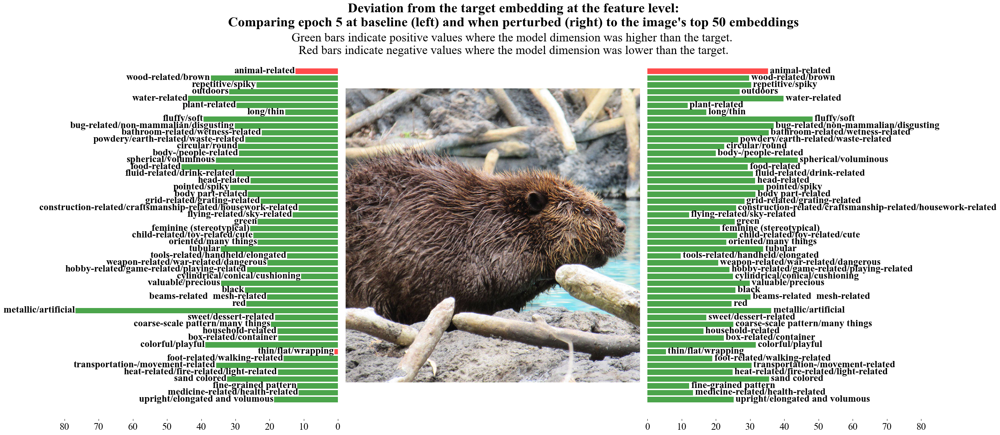

In [36]:
object = 'beaver_01b'
epoch = 5  # Change this value to set the epoch

# get the target embedding for the image

# path to target
target_embedding_path = Path('../Data/spose_embedding66d_rescaled_48val_reordered.csv')

target_embedding = pd.read_csv(target_embedding_path)

# Remove the 'Unnamed' column if it exists
target_embedding = target_embedding.loc[:, ~target_embedding.columns.str.contains('^Unnamed')]

target_embedding = target_embedding[target_embedding['image_name'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
target_embedding.columns = ['image_name'] + labels

# read in the baseline model at selected epoch

embeddings_baselin_seed1_epoch_path = f'/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results/things_48_embeddings_epoch{epoch}.csv'

embeddings_baselin_seed1_epoch = pd.read_csv(embeddings_baselin_seed1_epoch_path)

# min-max normalize the embeddings 0 to 100
# Select only numeric columns (exclude 'image')
numeric_cols = [col for col in embeddings_baselin_seed1_epoch.columns if col != 'image']
min_val = np.min(embeddings_baselin_seed1_epoch[numeric_cols].values)
max_val = np.max(embeddings_baselin_seed1_epoch[numeric_cols].values)

normalized_embeddings_baselin_seed1_epoch = embeddings_baselin_seed1_epoch.copy()
normalized_embeddings_baselin_seed1_epoch[numeric_cols] = 100 * (embeddings_baselin_seed1_epoch[numeric_cols] - min_val) / (max_val - min_val)

# filter for the object row
normalized_embeddings_baselin_seed1_epoch = normalized_embeddings_baselin_seed1_epoch[normalized_embeddings_baselin_seed1_epoch['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
normalized_embeddings_baselin_seed1_epoch.columns = ['image_name'] + labels

# get the embedding values
#embeddings_baselin_seed1_epoch98_values = embeddings_baselin_seed1_epoch98.values

# Calculate each feature in embeddings_baselin_seed1_epoch as a percent of the corresponding feature in target_embedding
# Select only numeric columns from each dataframe (exclude 'image'/'image_name')
numeric_cols_baseline = [col for col in normalized_embeddings_baselin_seed1_epoch.columns if col != 'image' and col != 'image_name']
numeric_cols_target = [col for col in target_embedding.columns if col != 'image_name']

# Get numeric values as arrays (align by position, not column name)
baseline_values = normalized_embeddings_baselin_seed1_epoch[numeric_cols_baseline].values
target_values = target_embedding[numeric_cols_target].values

baseline_diff = normalized_embeddings_baselin_seed1_epoch.iloc[0, 1:] - target_embedding.iloc[0, 1:]

print(baseline_diff)

# read in the embedding at the perturbed epoch

embeddings_sweep_seed42_epoch_path = f'/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run{epoch}/things_48_inference_results/things_48_embeddings_epoch{epoch}.csv'

embeddings_sweep_seed42_epoch = pd.read_csv(embeddings_sweep_seed42_epoch_path)

# min-max normalize the embeddings 0 to 100
# Select only numeric columns (exclude 'image')
numeric_cols = [col for col in embeddings_sweep_seed42_epoch.columns if col != 'image']
min_val = np.min(embeddings_sweep_seed42_epoch[numeric_cols].values)
max_val = np.max(embeddings_sweep_seed42_epoch[numeric_cols].values)

normalized_embeddings_sweep_seed42_epoch = embeddings_sweep_seed42_epoch.copy()
normalized_embeddings_sweep_seed42_epoch[numeric_cols] = 100 * (embeddings_sweep_seed42_epoch[numeric_cols] - min_val) / (max_val - min_val)

# filter for the object row
normalized_embeddings_sweep_seed42_epoch = normalized_embeddings_sweep_seed42_epoch[normalized_embeddings_sweep_seed42_epoch['image'].str.contains(object)]

path = '../Data/labels66.txt'
with open(path) as f:
    labels = f.readlines()
normalized_embeddings_sweep_seed42_epoch.columns = ['image_name'] + labels

# Calculate each feature in embeddings_baselin_seed1_epoch as a percent of the corresponding feature in target_embedding
# Select only numeric columns from each dataframe (exclude 'image'/'image_name')
numeric_cols_baseline = [col for col in normalized_embeddings_sweep_seed42_epoch.columns if col != 'image' and col != 'image_name']
numeric_cols_target = [col for col in target_embedding.columns if col != 'image_name']

# Get numeric values as arrays (align by position, not column name)
sweep_values = normalized_embeddings_sweep_seed42_epoch[numeric_cols_baseline].values
target_values = target_embedding[numeric_cols_target].values

sweep_diff = normalized_embeddings_sweep_seed42_epoch.iloc[0, 1:] - target_embedding.iloc[0, 1:]

# Load image
folder_path = '../Data/Things1854/'
image_path = folder_path + target_embedding['image_name'].values[0]
img = mpimg.imread(image_path)

# Load labels
label_path = '../Data/labels66.txt'
with open(label_path) as f:
    labels = f.readlines()

# baseline_diff and sweep_diff are Series (from iloc[0, 1:]), so rename their index
baseline_diff.index = labels
sweep_diff.index = labels

# Sort the target embedding values and get their indices to use as reference order (top = largest values)
target_sorted_indices = target_embedding.iloc[0, 1:].sort_values(ascending=False).head(49).index

# To ensure highest values are at the TOP of the histogram, reverse the order:
target_sorted_indices = target_sorted_indices[::-1]

# Use this order for both baseline and sweep percent results
baseline_diff_histogram = baseline_diff.loc[target_sorted_indices]
sweep_diff_histogram = sweep_diff.loc[target_sorted_indices]

# Format labels
baseline_diff_histogram.index = baseline_diff_histogram.index.str.replace(" / ", "/", regex=False)
sweep_diff_histogram.index = sweep_diff_histogram.index.str.replace(" / ", "/", regex=False)

# Determine colors and absolute values for baseline (left plot)
baseline_bar_colors = []
baseline_bar_values = []
for value in baseline_diff_histogram.values:
    if value >= 0:
        baseline_bar_colors.append('#008000')  # Green
        baseline_bar_values.append(abs(value))
    else:
        baseline_bar_colors.append('#FF0000')  # Red
        baseline_bar_values.append(abs(value))

# Determine colors and absolute values for sweep (right plot)
sweep_bar_colors = []
sweep_bar_values = []
for value in sweep_diff_histogram.values:
    if value >= 0:
        sweep_bar_colors.append('#008000')  # Green
        sweep_bar_values.append(abs(value))
    else:
        sweep_bar_colors.append('#FF0000')  # Red
        sweep_bar_values.append(abs(value))

# Find the global max absolute value to set same scale on both axes
global_max = max(
    max(baseline_bar_values) if baseline_bar_values else 0,
    max(sweep_bar_values) if sweep_bar_values else 0
)

# Buffer factor; should match visual proportion in original code
xlim_val = global_max * 1.12 if global_max != 0 else 100

fig, ax = plt.subplots(1, 3, figsize=(30, 12), gridspec_kw={'width_ratios': [1, 1, 1]})

# Left-side mirrored bar plot (baseline) - plot absolute values with color coding
ax[0].barh(range(len(baseline_bar_values)), baseline_bar_values, color=baseline_bar_colors, alpha=0.7)
ax[0].invert_xaxis()  # Flip the x-axis to go from max to 0
ax[0].set_xlim(xlim_val, 0)   # Set left axis to match right axis scale
ax[0].set_yticks([])
ax[0].tick_params(axis='x', labelsize=20)
for i, (value, label, orig_value) in enumerate(zip(baseline_bar_values, baseline_diff_histogram.index, baseline_diff_histogram.values)):
    ax[0].text(value + 0.15, i - 0.65, f'{label} ', va='center', ha='right', fontsize=20, fontweight='bold')
for spine in ax[0].spines.values():
    spine.set_visible(False)
ax[0].set_facecolor('none')

# Center image
ax[1].imshow(img)
ax[1].axis('off')
ax[1].set_facecolor('none')

# Right-side bar plot (sweep) - plot absolute values with color coding
ax[2].barh(range(len(sweep_bar_values)), sweep_bar_values, color=sweep_bar_colors, alpha=0.7)
ax[2].set_xlim(0, xlim_val)   # Axis scale matches left
ax[2].set_yticks([])
ax[2].tick_params(axis='x', labelsize=20)
for i, (value, label, orig_value) in enumerate(zip(sweep_bar_values, sweep_diff_histogram.index, sweep_diff_histogram.values)):
    ax[2].text(value - 0.15, i - 0.65, f' {label}', va='center', ha='left', fontsize=20, fontweight='bold')
for spine in ax[2].spines.values():
    spine.set_visible(False)
ax[2].set_facecolor('none')

# Set figure transparency
fig.patch.set_alpha(0)

fig.suptitle(
    f'Deviation from the target embedding at the feature level:\nComparing epoch {epoch} at baseline (left) and when perturbed (right) to the image\'s top 50 embeddings',
    fontsize=28, fontweight='bold', y=1.03
)

# Move the subtitle down below the title
fig.text(
    0.5,
    0.91,  # Lower y-value moves subtitle down
    "Green bars indicate positive values where the model dimension was higher than the target. \nRed bars indicate negative values where the model dimension was lower than the target.",
    fontsize=25,
    fontname='Times New Roman',
    ha='center'
)

# Adjust layout
plt.tight_layout()

# Save the figure
plt.savefig(f'../figures/{object}_vit_vs_hba_epoch{epoch}.svg', format='svg', bbox_inches='tight', transparent=True)

# Rank order embedding changes

Read in the baseline

In [40]:
baseline_seed1_48_things_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/baseline_runs/clip_hba_behavior_seed1/inference_results/things_48_inference_results')

baseline_seed1_48_things_files = sorted([f for f in baseline_seed1_48_things_dir.glob('things_48_embeddings*') if f.is_file()])

print(f"Found {len(baseline_seed1_48_things_files)} epochs:")
for run_dir in baseline_seed1_48_things_files:
    print(f"  - {run_dir.name}")

Found 98 epochs:
  - things_48_embeddings_epoch1.csv
  - things_48_embeddings_epoch10.csv
  - things_48_embeddings_epoch11.csv
  - things_48_embeddings_epoch12.csv
  - things_48_embeddings_epoch13.csv
  - things_48_embeddings_epoch14.csv
  - things_48_embeddings_epoch15.csv
  - things_48_embeddings_epoch16.csv
  - things_48_embeddings_epoch17.csv
  - things_48_embeddings_epoch18.csv
  - things_48_embeddings_epoch19.csv
  - things_48_embeddings_epoch2.csv
  - things_48_embeddings_epoch20.csv
  - things_48_embeddings_epoch21.csv
  - things_48_embeddings_epoch22.csv
  - things_48_embeddings_epoch23.csv
  - things_48_embeddings_epoch24.csv
  - things_48_embeddings_epoch25.csv
  - things_48_embeddings_epoch26.csv
  - things_48_embeddings_epoch27.csv
  - things_48_embeddings_epoch28.csv
  - things_48_embeddings_epoch29.csv
  - things_48_embeddings_epoch3.csv
  - things_48_embeddings_epoch30.csv
  - things_48_embeddings_epoch31.csv
  - things_48_embeddings_epoch32.csv
  - things_48_embeddings

In [41]:
baseline_seed1_48_things_paths = [baseline_seed1_48_things_dir / f.name for f in baseline_seed1_48_things_files]

baseline_seed1_48_things_dict = {}

# loop through the files and read in the embeddings
for path in baseline_seed1_48_things_paths:
    epoch = path.name.split('_')[3].split('.')[0]
    embeddings = pd.read_csv(path)
    baseline_seed1_48_things_dict[epoch] = embeddings

print(baseline_seed1_48_things_dict.keys())

# turn the dict into a dataframe and add the epoch as a column
baseline_seed1_48_things_df = pd.concat(
    [df.assign(epoch=epoch) for epoch, df in baseline_seed1_48_things_dict.items()],
    ignore_index=True
)

print(baseline_seed1_48_things_df.tail())

dict_keys(['epoch1', 'epoch10', 'epoch11', 'epoch12', 'epoch13', 'epoch14', 'epoch15', 'epoch16', 'epoch17', 'epoch18', 'epoch19', 'epoch2', 'epoch20', 'epoch21', 'epoch22', 'epoch23', 'epoch24', 'epoch25', 'epoch26', 'epoch27', 'epoch28', 'epoch29', 'epoch3', 'epoch30', 'epoch31', 'epoch32', 'epoch33', 'epoch34', 'epoch35', 'epoch36', 'epoch37', 'epoch38', 'epoch39', 'epoch4', 'epoch40', 'epoch41', 'epoch42', 'epoch43', 'epoch44', 'epoch45', 'epoch46', 'epoch47', 'epoch48', 'epoch49', 'epoch5', 'epoch50', 'epoch51', 'epoch52', 'epoch53', 'epoch54', 'epoch55', 'epoch56', 'epoch57', 'epoch58', 'epoch59', 'epoch6', 'epoch60', 'epoch61', 'epoch62', 'epoch63', 'epoch64', 'epoch65', 'epoch66', 'epoch67', 'epoch68', 'epoch69', 'epoch7', 'epoch70', 'epoch71', 'epoch72', 'epoch73', 'epoch74', 'epoch75', 'epoch76', 'epoch77', 'epoch78', 'epoch79', 'epoch8', 'epoch80', 'epoch81', 'epoch82', 'epoch83', 'epoch84', 'epoch85', 'epoch86', 'epoch87', 'epoch88', 'epoch89', 'epoch9', 'epoch90', 'epoch91

In [42]:
# sort the dictionary keys by epoch 
# Extract numeric part from keys like 'epoch1', 'epoch10', etc.
baseline_seed1_48_things_dict_sorted = sorted(baseline_seed1_48_things_dict.items(), key=lambda x: int(re.search(r'epoch(\d+)', x[0]).group(1)))

# print the keys in the list
print(baseline_seed1_48_things_dict_sorted)

[('epoch1',                      image          0          1          2          3  \
0            pizza_01b.jpg   6.943114  15.599767  11.636721   6.773570   
1           beaver_01b.jpg   7.223513   8.017966  11.591485   6.929740   
2        macadamia_01b.jpg  10.292803  13.199526  11.482669  11.987718   
3        tarantula_01b.jpg   7.184866   8.734017  14.029031  12.680639   
4          clothes_01b.jpg  12.073318   8.573022  10.531206  15.179026   
5          doormat_01b.jpg  10.962253   8.618795  11.226881  12.751110   
6           hammer_01b.jpg  13.734033   8.450418  10.958121  10.690629   
7        mistletoe_01b.jpg   9.526073   9.547226   8.164411  10.387193   
8        washcloth_01b.jpg   8.625125   9.130649   6.863123  12.877670   
9            drain_01b.jpg  13.833113   8.087058  11.464775  11.580210   
10         furnace_01b.jpg  12.609008   6.566987   7.330486   9.957274   
11             tea_01b.jpg   8.824909  10.941963   8.976460  11.269738   
12         chariot_01b.jpg

In [43]:
path = '../Data/labels66.txt'
with open(path) as f:
    labels = [line.strip() for line in f.readlines()]

# baseline_seed1_48_things_dict_sorted is a list of (epoch, dataframe) tuples
for epoch, df in baseline_seed1_48_things_dict_sorted:
    df.columns = ['image'] + labels

baseline_seed1_48_things_dict_sorted

[('epoch1',
                       image  metallic/artificial  food-related  animal-related  \
  0            pizza_01b.jpg             6.943114     15.599767       11.636721   
  1           beaver_01b.jpg             7.223513      8.017966       11.591485   
  2        macadamia_01b.jpg            10.292803     13.199526       11.482669   
  3        tarantula_01b.jpg             7.184866      8.734017       14.029031   
  4          clothes_01b.jpg            12.073318      8.573022       10.531206   
  5          doormat_01b.jpg            10.962253      8.618795       11.226881   
  6           hammer_01b.jpg            13.734033      8.450418       10.958121   
  7        mistletoe_01b.jpg             9.526073      9.547226        8.164411   
  8        washcloth_01b.jpg             8.625125      9.130649        6.863123   
  9            drain_01b.jpg            13.833113      8.087058       11.464775   
  10         furnace_01b.jpg            12.609008      6.566987        7.33

In [44]:
# Create rank-ordered embeddings for each epoch
# For each image (row), rank the embedding dimensions (columns) by their values
# Highest value gets rank 1, second highest gets rank 2, etc.

baseline_seed1_48_things_ranked_dict = {}

for epoch_key, df in baseline_seed1_48_things_dict_sorted:
    # Select only numeric columns (embedding dimensions) for ranking
    # This excludes any non-numeric columns like image names if they exist
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    
    # Create a copy to store ranked values
    ranked_df = df.copy()
    
    # Rank columns for each row (axis=1)
    # ascending=False means highest value gets rank 1
    # method='dense' handles ties by assigning the same rank
    ranked_df[numeric_cols] = df[numeric_cols].rank(axis=1, ascending=False, method='dense')
    
    # Store with the same epoch key
    baseline_seed1_48_things_ranked_dict[epoch_key] = ranked_df
    
    if epoch_key == baseline_seed1_48_things_dict_sorted[0][0]:  # Print details for first epoch
        print(f"Example: {epoch_key}")
        print(f"  Original shape: {df.shape}")
        print(f"  Numeric columns: {len(numeric_cols)}")
        print(f"  Sample ranking for first image:")
        print(f"    Original values (top 3): {df[numeric_cols].iloc[0].nlargest(3).to_dict()}")
        print(f"    Ranks (top 3): {ranked_df[numeric_cols].iloc[0].nsmallest(3).to_dict()}")

# Show epoch 5 as the example from baseline_seed1_48_things_ranked_dict,
# and print the same details as in the ranking loop for the fifth epoch.

example_epoch = "epoch5"
df = baseline_seed1_48_things_dict_sorted[4][1]  # 5th epoch's dataframe (0-indexed)
ranked_df = baseline_seed1_48_things_ranked_dict[example_epoch]
numeric_cols = df.select_dtypes(include=[np.number]).columns

print(f"Example: {example_epoch}")
print(f"  Original shape: {df.shape}")
print(f"  Numeric columns: {len(numeric_cols)}")
print(f"  Sample ranking for first image:")
print(f"    Original values (top 3): {df[numeric_cols].iloc[0].nlargest(3).to_dict()}")
print(f"    Ranks (top 3): {ranked_df[numeric_cols].iloc[0].nsmallest(3).to_dict()}")

print(f"Example key: '{example_epoch}'")
print(ranked_df.head(2))

Example: epoch1
  Original shape: (48, 67)
  Numeric columns: 66
  Sample ranking for first image:
    Original values (top 3): {'food-related': 15.599767, 'bug-related / non-mammalian / disgusting': 15.335326, 'thin / flat / wrapping': 15.081249}
    Ranks (top 3): {'food-related': 1.0, 'bug-related / non-mammalian / disgusting': 2.0, 'thin / flat / wrapping': 3.0}
Example: epoch5
  Original shape: (48, 67)
  Numeric columns: 66
  Sample ranking for first image:
    Original values (top 3): {'food-related': 17.201605, 'metallic/artificial': 14.741895, 'animal-related': 13.167943}
    Ranks (top 3): {'food-related': 1.0, 'metallic/artificial': 2.0, 'animal-related': 3.0}
Example key: 'epoch5'
            image  metallic/artificial  food-related  animal-related  textile  \
0   pizza_01b.jpg                  2.0           1.0             3.0     26.0   
1  beaver_01b.jpg                  2.0           5.0             1.0      8.0   

   plant-related  house-related/furnishing-related  va

Read in the single-epoch perturbation at epoch 5

In [45]:
# Directory containing the perturbation sweep results at epoch 5
sweep_trainingrun5_48_things_dir = Path('/home/wallacelab/teba/multimodal_brain_inspired/marren/temporal_dynamics_of_human_alignment/single_epoch_perturbation_sweeps/perturb_sweep_baselineseed1_perturbseed42/training_run5/things_48_inference_results')

sweep_trainingrun5_48_things_files = sorted([f for f in sweep_trainingrun5_48_things_dir.glob('things_48_embeddings*') if f.is_file()])

print(f"Found {len(sweep_trainingrun5_48_things_files)} epochs:")
for run_dir in sweep_trainingrun5_48_things_files:
    print(f"  - {run_dir.name}")

Found 82 epochs:
  - things_48_embeddings_epoch10.csv
  - things_48_embeddings_epoch11.csv
  - things_48_embeddings_epoch12.csv
  - things_48_embeddings_epoch13.csv
  - things_48_embeddings_epoch14.csv
  - things_48_embeddings_epoch15.csv
  - things_48_embeddings_epoch16.csv
  - things_48_embeddings_epoch17.csv
  - things_48_embeddings_epoch18.csv
  - things_48_embeddings_epoch19.csv
  - things_48_embeddings_epoch20.csv
  - things_48_embeddings_epoch21.csv
  - things_48_embeddings_epoch22.csv
  - things_48_embeddings_epoch23.csv
  - things_48_embeddings_epoch24.csv
  - things_48_embeddings_epoch25.csv
  - things_48_embeddings_epoch26.csv
  - things_48_embeddings_epoch27.csv
  - things_48_embeddings_epoch28.csv
  - things_48_embeddings_epoch29.csv
  - things_48_embeddings_epoch30.csv
  - things_48_embeddings_epoch31.csv
  - things_48_embeddings_epoch32.csv
  - things_48_embeddings_epoch33.csv
  - things_48_embeddings_epoch34.csv
  - things_48_embeddings_epoch35.csv
  - things_48_embeddi

In [46]:
sweep_trainingrun5_48_things_paths = [sweep_trainingrun5_48_things_dir / f.name for f in sweep_trainingrun5_48_things_files]

sweep_trainingrun5_48_things_dict = {}

# loop through the files and read in the embeddings
for path in sweep_trainingrun5_48_things_paths:
    epoch = path.name.split('_')[3].split('.')[0]
    embeddings = pd.read_csv(path)
    sweep_trainingrun5_48_things_dict[epoch] = embeddings

print(sweep_trainingrun5_48_things_dict.keys())

# turn the dict into a dataframe and add the epoch as a column
sweep_trainingrun5_48_things_df = pd.concat(
    [df.assign(epoch=epoch) for epoch, df in sweep_trainingrun5_48_things_dict.items()],
    ignore_index=True
)

print(sweep_trainingrun5_48_things_df.tail())

dict_keys(['epoch10', 'epoch11', 'epoch12', 'epoch13', 'epoch14', 'epoch15', 'epoch16', 'epoch17', 'epoch18', 'epoch19', 'epoch20', 'epoch21', 'epoch22', 'epoch23', 'epoch24', 'epoch25', 'epoch26', 'epoch27', 'epoch28', 'epoch29', 'epoch30', 'epoch31', 'epoch32', 'epoch33', 'epoch34', 'epoch35', 'epoch36', 'epoch37', 'epoch38', 'epoch39', 'epoch40', 'epoch41', 'epoch42', 'epoch43', 'epoch44', 'epoch45', 'epoch46', 'epoch47', 'epoch48', 'epoch49', 'epoch5', 'epoch50', 'epoch51', 'epoch52', 'epoch53', 'epoch54', 'epoch55', 'epoch56', 'epoch57', 'epoch58', 'epoch59', 'epoch6', 'epoch60', 'epoch61', 'epoch62', 'epoch63', 'epoch64', 'epoch65', 'epoch66', 'epoch67', 'epoch68', 'epoch69', 'epoch7', 'epoch70', 'epoch71', 'epoch72', 'epoch73', 'epoch74', 'epoch75', 'epoch76', 'epoch77', 'epoch78', 'epoch79', 'epoch8', 'epoch80', 'epoch81', 'epoch82', 'epoch83', 'epoch84', 'epoch85', 'epoch86', 'epoch9'])
                     image          0          1          2          3  \
3931     telegrap

In [47]:
# sort the dictionary keys by epoch 
# Extract numeric part from keys like 'epoch1', 'epoch10', etc.
sweep_trainingrun5_48_things_dict_sorted = sorted(sweep_trainingrun5_48_things_dict.items(), key=lambda x: int(re.search(r'epoch(\d+)', x[0]).group(1)))

# print the keys in the list
print(sweep_trainingrun5_48_things_dict_sorted)

[('epoch5',                      image          0          1          2          3  \
0            pizza_01b.jpg   3.760228  11.751761   5.948312   1.854817   
1           beaver_01b.jpg   6.080522   5.232914   9.709425   2.933445   
2        macadamia_01b.jpg   8.915843  11.156794   7.902397   8.399467   
3        tarantula_01b.jpg   5.107970   4.702393   9.896120   7.274232   
4          clothes_01b.jpg   9.109113   4.567394   5.050641  10.389703   
5          doormat_01b.jpg   8.220489   3.220287   4.556961   7.198938   
6           hammer_01b.jpg  11.860644   4.969193   6.682228   6.655228   
7        mistletoe_01b.jpg   8.261316   6.991774   4.314702   7.237492   
8        washcloth_01b.jpg   7.154916   6.305078   2.436299   8.972821   
9            drain_01b.jpg  10.869675   3.239830   5.338375   6.149491   
10         furnace_01b.jpg  11.716960   4.221544   4.132684   6.433042   
11             tea_01b.jpg   7.859759   9.368220   5.738781   7.995802   
12         chariot_01b.jpg

In [48]:
path = '../Data/labels66.txt'
with open(path) as f:
    labels = [line.strip() for line in f.readlines()]

# baseline_seed1_48_things_dict_sorted is a list of (epoch, dataframe) tuples
for epoch, df in sweep_trainingrun5_48_things_dict_sorted:
    df.columns = ['image'] + labels

sweep_trainingrun5_48_things_dict_sorted

[('epoch5',
                       image  metallic/artificial  food-related  animal-related  \
  0            pizza_01b.jpg             3.760228     11.751761        5.948312   
  1           beaver_01b.jpg             6.080522      5.232914        9.709425   
  2        macadamia_01b.jpg             8.915843     11.156794        7.902397   
  3        tarantula_01b.jpg             5.107970      4.702393        9.896120   
  4          clothes_01b.jpg             9.109113      4.567394        5.050641   
  5          doormat_01b.jpg             8.220489      3.220287        4.556961   
  6           hammer_01b.jpg            11.860644      4.969193        6.682228   
  7        mistletoe_01b.jpg             8.261316      6.991774        4.314702   
  8        washcloth_01b.jpg             7.154916      6.305078        2.436299   
  9            drain_01b.jpg            10.869675      3.239830        5.338375   
  10         furnace_01b.jpg            11.716960      4.221544        4.13

In [49]:
# Create rank-ordered embeddings for each epoch
# For each image (row), rank the embedding dimensions (columns) by their values
# Highest value gets rank 1, second highest gets rank 2, etc.

sweep_trainingrun5_48_things_ranked_dict = {}

for epoch_key, df in sweep_trainingrun5_48_things_dict_sorted:
    # Select only numeric columns (embedding dimensions) for ranking
    # This excludes any non-numeric columns like image names if they exist
    numeric_cols = df.select_dtypes(include=[np.number]).columns
    
    # Create a copy to store ranked values
    ranked_df = df.copy()
    
    # Rank columns for each row (axis=1)
    # ascending=False means highest value gets rank 1
    # method='dense' handles ties by assigning the same rank
    ranked_df[numeric_cols] = df[numeric_cols].rank(axis=1, ascending=False, method='dense')
    
    # Store with the same epoch key
    sweep_trainingrun5_48_things_ranked_dict[epoch_key] = ranked_df
    
    if epoch_key == sweep_trainingrun5_48_things_dict_sorted[0][0]:  # Print details for first epoch
        print(f"Example: {epoch_key}")
        print(f"  Original shape: {df.shape}")
        print(f"  Numeric columns: {len(numeric_cols)}")
        print(f"  Sample ranking for first image:")
        print(f"    Original values (top 3): {df[numeric_cols].iloc[0].nlargest(3).to_dict()}")
        print(f"    Ranks (top 3): {ranked_df[numeric_cols].iloc[0].nsmallest(3).to_dict()}")

# Show an example from baseline_seed1_48_things_ranked_dict:
example_epoch = list(sweep_trainingrun5_48_things_ranked_dict.keys())[0]
print(f"Example key: '{example_epoch}'")
print(sweep_trainingrun5_48_things_ranked_dict[example_epoch].head(2))

Example: epoch5
  Original shape: (48, 67)
  Numeric columns: 66
  Sample ranking for first image:
    Original values (top 3): {'food-related': 11.751761, 'yellow': 9.278833, 'circular / round': 8.83803}
    Ranks (top 3): {'food-related': 1.0, 'yellow': 2.0, 'circular / round': 3.0}


Example key: 'epoch5'
            image  metallic/artificial  food-related  animal-related  textile  \
0   pizza_01b.jpg                 58.0           1.0            30.0     66.0   
1  beaver_01b.jpg                 11.0          19.0             1.0     55.0   

   plant-related  house-related/furnishing-related  valuable/precious  \
0           44.0                              57.0                8.0   
1           56.0                              45.0               25.0   

   transportation-/movement-related  body-/people-related  ...  \
0                              54.0                  37.0  ...   
1                              26.0                  47.0  ...   

   medicine-related / health-related  sweet / dessert-related  orange  \
0                               42.0                      9.0    11.0   
1                               63.0                     58.0    18.0   

   thin / flat / wrapping  cylindrical / conical / cushioning  \
0                    10.0     

In [50]:
# Compare ranks between baseline and sweep
# For each epoch in baseline, if matching epoch exists in sweep:
#   For each image (row):
#     - For every dimension (column):
#       - Get the rank of that dimension for that image in baseline
#       - Get the rank of that dimension for that image in sweep
#       - Calculate: baseline_rank - sweep_rank

baseline_sweep_rank_differences = {}

for epoch_key, baseline_df in baseline_seed1_48_things_ranked_dict.items():
    # Check if matching epoch exists in sweep
    if epoch_key not in sweep_trainingrun5_48_things_ranked_dict:
        print(f"Skipping {epoch_key}: no matching epoch in sweep")
        continue
    
    sweep_df = sweep_trainingrun5_48_things_ranked_dict[epoch_key]
    
    # Get numeric columns (embedding dimensions)
    baseline_numeric_cols = baseline_df.select_dtypes(include=[np.number]).columns
    sweep_numeric_cols = sweep_df.select_dtypes(include=[np.number]).columns
    
    # Ensure both dataframes have the same columns and rows
    common_cols = baseline_numeric_cols.intersection(sweep_numeric_cols)
    if len(common_cols) == 0:
        print(f"Skipping {epoch_key}: no common columns")
        continue
    
    # Ensure same number of rows and same index
    if len(baseline_df) != len(sweep_df):
        print(f"Warning: {epoch_key} has different number of rows ({len(baseline_df)} vs {len(sweep_df)})")
        continue
    
    # Store rank differences for this epoch
    rank_differences = []
    
    # Loop through each row (image)
    for idx in baseline_df.index:
        # Get image identifier
        image_id = baseline_df.loc[idx, 'image'] if 'image' in baseline_df.columns else idx
        
        # Loop through every dimension (column)
        for col in common_cols:
            baseline_rank = baseline_df.loc[idx, col]
            sweep_rank = sweep_df.loc[idx, col]
            
            # Calculate difference: baseline_rank - sweep_rank
            rank_diff = baseline_rank - sweep_rank
            
            rank_differences.append({
                'image': image_id,
                'dimension': col,
                'baseline_rank': baseline_rank,
                'sweep_rank': sweep_rank,
                'rank_difference': rank_diff
            })
    
    # Store results for this epoch
    baseline_sweep_rank_differences[epoch_key] = pd.DataFrame(rank_differences)
    
    if epoch_key == list(baseline_seed1_48_things_ranked_dict.keys())[0]:  # Print example for first epoch
        print(f"Example epoch: {epoch_key}")
        print(f"  Total comparisons: {len(rank_differences)}")
        print(f"  Expected: {len(baseline_df)} images × {len(common_cols)} dimensions = {len(baseline_df) * len(common_cols)}")
        print(f"  Sample differences:")
        print(baseline_sweep_rank_differences[epoch_key].head(10))

print(f"\nTotal epochs compared: {len(baseline_sweep_rank_differences)}")


Skipping epoch1: no matching epoch in sweep
Skipping epoch2: no matching epoch in sweep
Skipping epoch3: no matching epoch in sweep
Skipping epoch4: no matching epoch in sweep
Skipping epoch87: no matching epoch in sweep
Skipping epoch88: no matching epoch in sweep
Skipping epoch89: no matching epoch in sweep
Skipping epoch90: no matching epoch in sweep
Skipping epoch91: no matching epoch in sweep
Skipping epoch92: no matching epoch in sweep
Skipping epoch93: no matching epoch in sweep
Skipping epoch94: no matching epoch in sweep
Skipping epoch95: no matching epoch in sweep
Skipping epoch96: no matching epoch in sweep
Skipping epoch97: no matching epoch in sweep
Skipping epoch98: no matching epoch in sweep

Total epochs compared: 82


In [51]:
# Compare original embedding values (not ranks) for all dimensions
# For each epoch in baseline ranked dict, if matching epoch exists in sweep:
#   For each image (row):
#     - For every dimension (column):
#       - Get the original VALUE for that dimension in baseline dict
#       - Get the original VALUE for that dimension in sweep dict
#       - Calculate: baseline_value - sweep_value

# Convert sorted lists to dictionaries for easier lookup
baseline_seed1_48_things_dict = dict(baseline_seed1_48_things_dict_sorted)
sweep_trainingrun5_48_things_dict = dict(sweep_trainingrun5_48_things_dict_sorted)

baseline_sweep_value_differences = {}

for epoch_key, baseline_ranked_df in baseline_seed1_48_things_ranked_dict.items():
    # Check if matching epoch exists in sweep
    if epoch_key not in sweep_trainingrun5_48_things_dict:
        print(f"Skipping {epoch_key}: no matching epoch in sweep")
        continue
    
    # Get original value dataframes (not ranked)
    baseline_df = baseline_seed1_48_things_dict[epoch_key]
    sweep_df = sweep_trainingrun5_48_things_dict[epoch_key]
    
    # Get numeric columns (embedding dimensions)
    baseline_ranked_numeric_cols = baseline_ranked_df.select_dtypes(include=[np.number]).columns
    baseline_numeric_cols = baseline_df.select_dtypes(include=[np.number]).columns
    sweep_numeric_cols = sweep_df.select_dtypes(include=[np.number]).columns
    
    # Ensure all dataframes have the same columns and rows
    common_cols = baseline_ranked_numeric_cols.intersection(baseline_numeric_cols).intersection(sweep_numeric_cols)
    if len(common_cols) == 0:
        print(f"Skipping {epoch_key}: no common columns")
        continue
    
    # Ensure same number of rows
    if len(baseline_ranked_df) != len(baseline_df) or len(baseline_df) != len(sweep_df):
        print(f"Warning: {epoch_key} has different number of rows")
        continue
    
    # Store value differences for this epoch
    value_differences = []
    
    # Loop through each row (image)
    for idx in baseline_ranked_df.index:
        # Get image identifier
        image_id = baseline_df.loc[idx, 'image'] if 'image' in baseline_df.columns else idx
        
        # Loop through every dimension (column)
        for col in common_cols:
            baseline_value = baseline_df.loc[idx, col]
            sweep_value = sweep_df.loc[idx, col]
            baseline_rank = baseline_ranked_df.loc[idx, col]
            
            # Calculate difference: baseline_value - sweep_value
            value_diff = sweep_value - baseline_value
            
            value_differences.append({
                'image': image_id,
                'dimension': col,
                'baseline_rank': baseline_rank,
                'baseline_value': baseline_value,
                'sweep_value': sweep_value,
                'value_difference': value_diff
            })
    
    # Store results for this epoch
    baseline_sweep_value_differences[epoch_key] = pd.DataFrame(value_differences)
    
    if epoch_key == list(baseline_seed1_48_things_ranked_dict.keys())[0]:  # Print example for first epoch
        print(f"Example epoch: {epoch_key}")
        print(f"  Total comparisons: {len(value_differences)}")
        print(f"  Expected: {len(baseline_df)} images × {len(common_cols)} dimensions = {len(baseline_df) * len(common_cols)}")
        print(f"  Sample value differences:")
        print(baseline_sweep_value_differences[epoch_key].head(10))

print(f"\nTotal epochs compared: {len(baseline_sweep_value_differences)}")


Skipping epoch1: no matching epoch in sweep
Skipping epoch2: no matching epoch in sweep
Skipping epoch3: no matching epoch in sweep
Skipping epoch4: no matching epoch in sweep


Skipping epoch87: no matching epoch in sweep
Skipping epoch88: no matching epoch in sweep
Skipping epoch89: no matching epoch in sweep
Skipping epoch90: no matching epoch in sweep
Skipping epoch91: no matching epoch in sweep
Skipping epoch92: no matching epoch in sweep
Skipping epoch93: no matching epoch in sweep
Skipping epoch94: no matching epoch in sweep
Skipping epoch95: no matching epoch in sweep
Skipping epoch96: no matching epoch in sweep
Skipping epoch97: no matching epoch in sweep
Skipping epoch98: no matching epoch in sweep

Total epochs compared: 82


In [52]:
print(baseline_sweep_value_differences)

{'epoch5':                image                              dimension  baseline_rank  \
0      pizza_01b.jpg                    metallic/artificial            2.0   
1      pizza_01b.jpg                           food-related            1.0   
2      pizza_01b.jpg                         animal-related            3.0   
3      pizza_01b.jpg                                textile           26.0   
4      pizza_01b.jpg                          plant-related            9.0   
...              ...                                    ...            ...   
3163  bucket_01b.jpg      coldness-related / winter-related           63.0   
3164  bucket_01b.jpg  measurement-related / numbers-related           41.0   
3165  bucket_01b.jpg                          fluffy / soft           61.0   
3166  bucket_01b.jpg              masculine (stereotypical)           60.0   
3167  bucket_01b.jpg                   fine-grained pattern           58.0   

      baseline_value  sweep_value  value_difference 

In [53]:
# Average the value_difference for every image's dimensions at each rank level
# For each epoch:
#   - For each rank (1, 2, 3, etc.):
#     - Find all dimensions with that rank for each image
#     - Get the value_difference for those dimension-image pairs
#     - Average across all images in that epoch

baseline_sweep_ranked_value_differences_avg = {}

for epoch_key, value_diff_df in baseline_sweep_value_differences.items():
    if len(value_diff_df) == 0:
        print(f"Warning: {epoch_key} has no data")
        continue
    
    # Get unique ranks in this epoch
    unique_ranks = sorted(value_diff_df['baseline_rank'].unique())
    
    rank_stats = {}
    
    # For each rank level
    for rank in unique_ranks:
        # Filter to dimensions with this rank
        rank_df = value_diff_df[value_diff_df['baseline_rank'] == rank].copy()
        
        if len(rank_df) == 0:
            continue
        
        # Handle ties: if an image has multiple dimensions with the same rank, average them
        # Group by image and average the value_difference for tied dimensions at this rank
        image_avg_differences = rank_df.groupby('image')['value_difference'].mean()
        
        # Average across all images in this epoch for this rank
        rank_avg = image_avg_differences.mean()
        
        rank_stats[rank] = {
            'average_value_difference': rank_avg,
            'num_images': len(image_avg_differences),
            'num_comparisons': len(rank_df),
            'std_value_difference': image_avg_differences.std(),
            'min_value_difference': image_avg_differences.min(),
            'max_value_difference': image_avg_differences.max()
        }
    
    baseline_sweep_ranked_value_differences_avg[epoch_key] = rank_stats

# Convert to a more readable format: DataFrame with epoch and rank as index
all_results = []
for epoch_key, rank_stats in baseline_sweep_ranked_value_differences_avg.items():
    for rank, stats in rank_stats.items():
        all_results.append({
            'epoch': epoch_key,
            'rank': rank,
            **stats
        })

ranked_avg_results_df = pd.DataFrame(all_results)

print("Average value_difference for each rank level per epoch:")
print(ranked_avg_results_df.head(30))
print(f"\nTotal epoch-rank combinations: {len(ranked_avg_results_df)}")
print(f"\nUnique ranks: {sorted(ranked_avg_results_df['rank'].unique())}")
print(f"\nOverall statistics by rank:")
rank_summary = ranked_avg_results_df.groupby('rank')['average_value_difference'].agg(['mean', 'std', 'min', 'max'])
print(rank_summary.head(20))


Average value_difference for each rank level per epoch:
     epoch  rank  average_value_difference  num_images  num_comparisons  \
0   epoch5   1.0                -10.980766          48               48   
1   epoch5   2.0                 -5.323196          48               48   
2   epoch5   3.0                 -3.574839          48               48   
3   epoch5   4.0                 -4.074532          48               48   
4   epoch5   5.0                 -2.880641          48               48   
5   epoch5   6.0                 -2.548991          48               48   
6   epoch5   7.0                 -2.350884          48               48   
7   epoch5   8.0                 -2.605469          48               48   
8   epoch5   9.0                 -2.232164          48               48   
9   epoch5  10.0                 -1.777230          48               48   
10  epoch5  11.0                 -1.619993          48               48   
11  epoch5  12.0                 -2.002843  

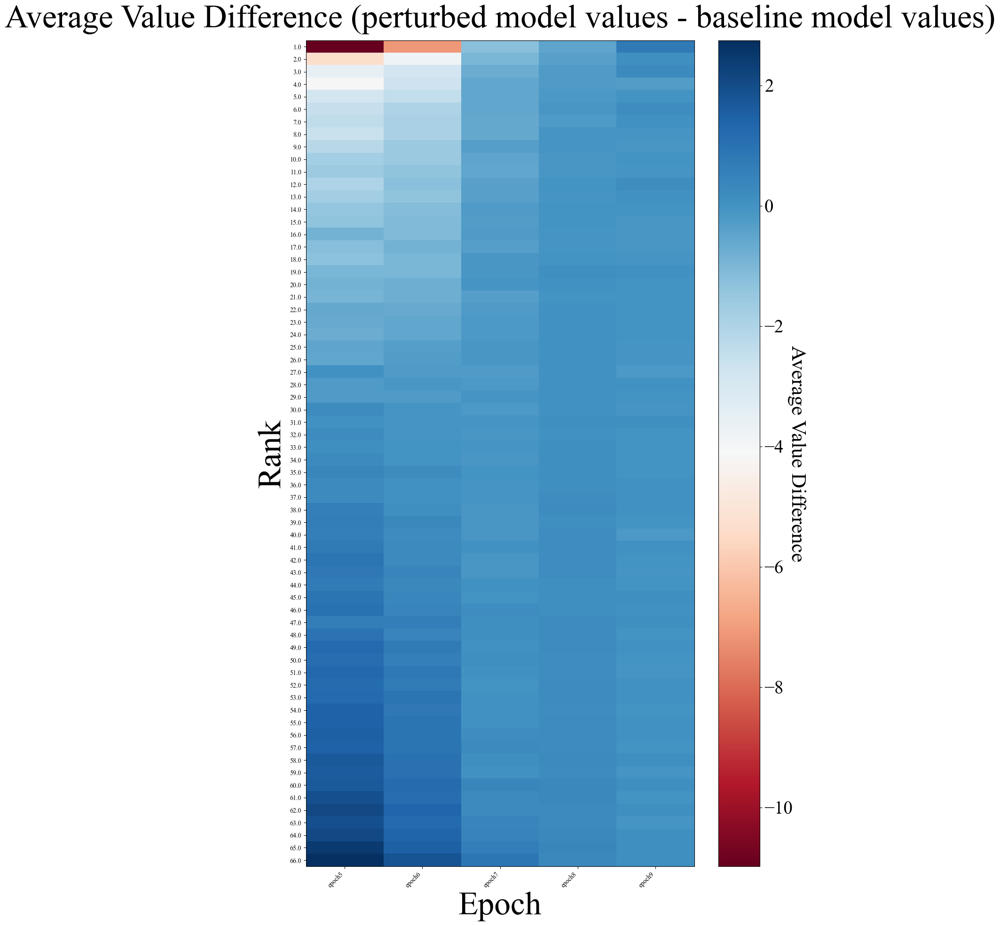

Heatmap dimensions: 66 ranks × 5 epochs
Value range: -10.980766 to 2.746470


In [58]:
# Create a heatmap: rank on y-axis, epoch on x-axis, average_value_difference as cell values
# Only show the first 5 epochs

# Pivot the DataFrame to have epochs as columns and ranks as rows
heatmap_data = ranked_avg_results_df.pivot(index='rank', columns='epoch', values='average_value_difference')

# Sort epochs numerically (handle 'epoch1', 'epoch10', etc.)
def extract_epoch_num(epoch_str):
    """Extract numeric part from epoch string like 'epoch1', 'epoch10'"""
    match = re.search(r'epoch(\d+)', str(epoch_str))
    return int(match.group(1)) if match else 0

# Sort columns (epochs) by their numeric value
epoch_cols = sorted(heatmap_data.columns, key=extract_epoch_num)

# Only keep the first 5 epochs
epoch_cols = epoch_cols[:5]
heatmap_data = heatmap_data[epoch_cols]

# Sort rows (ranks) numerically
heatmap_data = heatmap_data.sort_index()

# Create the heatmap
fig, ax = plt.subplots(figsize=(max(12, len(epoch_cols) * 0.3), max(8, len(heatmap_data) * 0.3)))

# Flip the color scale: use 'RdBu' so blue = positive, red = negative
im = ax.imshow(heatmap_data.values, aspect='auto', cmap='RdBu', interpolation='nearest')

# Set ticks and labels
ax.set_xticks(np.arange(len(epoch_cols)))
ax.set_xticklabels(epoch_cols, rotation=45, ha='right')
ax.set_yticks(np.arange(len(heatmap_data.index)))
ax.set_yticklabels(heatmap_data.index)

# Add colorbar
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('Average Value Difference', rotation=270, labelpad=20, fontsize=32)
cbar.ax.tick_params(labelsize=28)

# Add labels
ax.set_xlabel('Epoch', fontsize=50)
ax.set_ylabel('Rank', fontsize=50)
ax.set_title('Average Value Difference (perturbed model values - baseline model values)', fontsize=50, pad=20)

# Add text annotations for better readability (optional, can be slow for large heatmaps)
# Only add text if the heatmap is not too large
if len(heatmap_data) <= 20 and len(epoch_cols) <= 30:
    for i in range(len(heatmap_data.index)):
        for j in range(len(epoch_cols)):
            text = ax.text(j, i, f'{heatmap_data.iloc[i, j]:.3f}',
                         ha="center", va="center", color="black", fontsize=8)

plt.tight_layout()
plt.show()

print(f"Heatmap dimensions: {heatmap_data.shape[0]} ranks × {heatmap_data.shape[1]} epochs")
print(f"Value range: {heatmap_data.min().min():.6f} to {heatmap_data.max().max():.6f}")


In [55]:
print(baseline_sweep_value_differences)

{'epoch5':                image                              dimension  baseline_rank  \
0      pizza_01b.jpg                    metallic/artificial            2.0   
1      pizza_01b.jpg                           food-related            1.0   
2      pizza_01b.jpg                         animal-related            3.0   
3      pizza_01b.jpg                                textile           26.0   
4      pizza_01b.jpg                          plant-related            9.0   
...              ...                                    ...            ...   
3163  bucket_01b.jpg      coldness-related / winter-related           63.0   
3164  bucket_01b.jpg  measurement-related / numbers-related           41.0   
3165  bucket_01b.jpg                          fluffy / soft           61.0   
3166  bucket_01b.jpg              masculine (stereotypical)           60.0   
3167  bucket_01b.jpg                   fine-grained pattern           58.0   

      baseline_value  sweep_value  value_difference 